In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as m_dates
from itertools import product
import yaml
pd.set_option('display.max_colwidth', 100)
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
with open("../config/inputs.yaml") as file:
    cfg = yaml.load(file, Loader=yaml.FullLoader)

In [3]:
output_dir = cfg.get('output_dir')
eval_params = cfg.get('eval_params')
time_horizons = eval_params.get('time_horizons')
metrics = eval_params.get('metrics')
commods = cfg.get('commod_ids')
commods

['WTIPUUS',
 'BREPUUS',
 'MGWHUUS',
 'DSWHUUS',
 'D2WHUUS',
 'MGRARUS',
 'MGEIAUS',
 'DSRTUUS',
 'D2RCAUS',
 'NGHHMCF',
 'NGRCUUS',
 'ESRCUUS']

In [4]:
def line_plot_date(
        idf: pd.DataFrame,
        x_ax: str,
        y_ax: list,
        title: str,
        labels: tuple,
        markers=None,  # list of tuples: [ (col_name, marker), ... ]
        date_grid_major="y",  # y = years, m = months, d = days
        date_grid_minor="m",  # y = years, m = months, d = days
        date_format="%Y-%m",
        fig_size=(10, 5),
        legend=True,
        vertical_marker=False
):
    df = idf.copy()
    df.reset_index(inplace=True)
    df[x_ax] = pd.to_datetime(df[x_ax])
    years = m_dates.YearLocator()  # every year
    months = m_dates.MonthLocator()  # every month
    days = m_dates.DayLocator()  # every month
    hours = m_dates.HourLocator()  # every hour
    minutes = m_dates.MinuteLocator()  # every minute
    years_fmt = m_dates.DateFormatter(date_format)

    fig, ax = plt.subplots(figsize=fig_size)
    for _y_ax in y_ax:
        ax.plot(x_ax, _y_ax, data=df)

    # plot markers
    markers = {} if markers is None else markers
    for marker_name, marker_info in markers.items():
        # get index values where marker is True
        marker_array = list(df[df[marker_name]].index.values)
        marker_target, marker_shape = marker_info
        marker_color = marker_shape[0]

        # plot markers
        ax.plot(
            df[x_ax],
            df[marker_target],
            marker_shape,
            markersize=12,
            markevery=marker_array
        )
        if vertical_marker:
            for marker_val in marker_array:
                ax.axvline(x=df[x_ax][marker_val], color=marker_color)

    # format the ticks
    loc_map = {"y": years, "m": months, "d": days, "h": hours, "i": minutes}
    ax.xaxis.set_major_locator(loc_map[date_grid_major])
    ax.xaxis.set_major_formatter(years_fmt)
    ax.xaxis.set_minor_locator(loc_map[date_grid_minor])

    # noinspection SpellCheckingInspection
    datemin, datemax = min(df[x_ax]), max(df[x_ax])
    ax.set_xlim(datemin, datemax)

    ax.set(xlabel=labels[0], ylabel=labels[1], title=title)
    ax.grid(True)
    ax.axis('tight')
    if legend:
        ax.legend(
            loc='best', ncol=1, bbox_to_anchor=(1, 0.5)
        )

    fig.autofmt_xdate()

    plt_obj = plt.gcf()
    plt.show()
    print("\n\n")

Plotting Evaluations for WTIPUUS_price


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,WTIPUUS,2005-01-01,3.840000,14.745601,3.840000,3.840000,4.245001,18.184058,4.264277,4.650002,...,8.818143,13.209999,12.162222,191.196988,13.827400,22.729996,13.451666,219.040944,14.800032,22.729996
1,WTIPUUS,2005-02-01,1.339291,1.793699,1.339291,1.339291,4.563461,31.220456,5.587527,7.787632,...,8.359654,13.593197,11.347237,172.880610,13.148407,20.732365,12.759451,204.577387,14.303055,21.575672
2,WTIPUUS,2005-03-01,3.310001,10.956109,3.310001,3.310001,3.240000,10.502499,3.240756,3.310001,...,8.312998,15.850002,8.816666,108.767005,10.429142,16.729996,10.132499,132.779778,11.523011,17.380005
3,WTIPUUS,2005-04-01,4.020000,16.160404,4.020000,4.020000,5.519999,32.720378,5.720173,7.019997,...,6.226146,9.339996,4.879999,32.139580,5.669178,9.339996,5.601666,39.778139,6.306991,9.830002
4,WTIPUUS,2005-05-01,0.169998,0.028899,0.169998,0.169998,3.134998,18.619440,4.315025,6.099998,...,9.446049,13.489998,8.369999,87.398751,9.348730,13.489998,9.465833,109.328809,10.456042,17.690010
5,WTIPUUS,2005-06-01,4.349998,18.922487,4.349998,4.349998,5.674999,33.961243,5.827628,7.000000,...,8.316355,12.489998,7.698888,69.278533,8.323373,12.489998,9.271667,104.190188,10.207360,17.339996
6,WTIPUUS,2005-07-01,0.500000,0.250000,0.500000,0.500000,3.200001,17.530009,4.186885,5.900002,...,3.652728,5.989998,3.971110,22.609774,4.754974,7.980003,6.455833,65.363312,8.084758,14.339996
7,WTIPUUS,2005-08-01,6.031883,36.383615,6.031883,6.031883,5.997164,35.981527,5.998460,6.121880,...,5.274226,8.757442,6.007323,50.883023,7.133234,14.485962,8.501972,102.426201,10.120583,17.691715
8,WTIPUUS,2005-09-01,4.010002,16.080117,4.010002,4.010002,5.150003,27.822138,5.274669,6.290005,...,5.947253,10.029999,5.150002,37.469363,6.121222,10.029999,6.270835,51.802210,7.197375,11.410004
9,WTIPUUS,2005-10-01,1.490002,2.220105,1.490002,1.490002,3.835001,20.206254,4.495137,6.180000,...,3.642111,6.180000,4.126668,23.673784,4.865571,7.089996,4.753335,32.259696,5.679762,10.160004


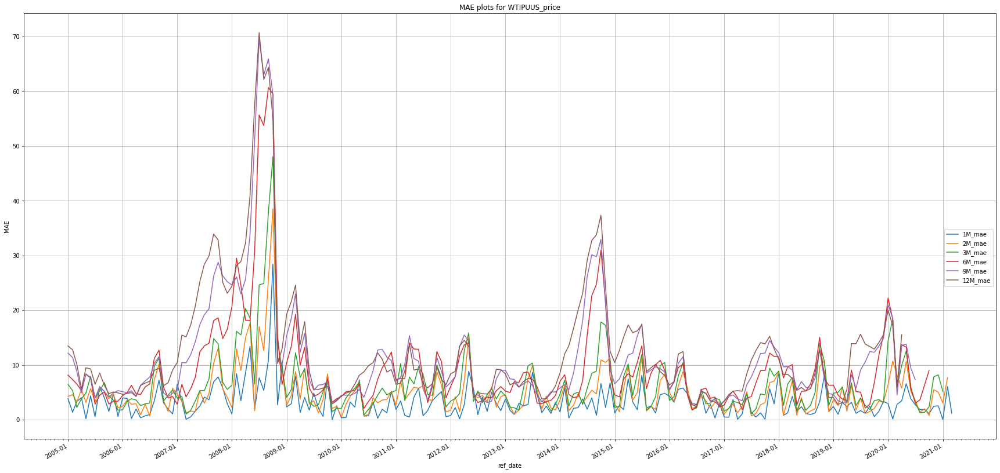

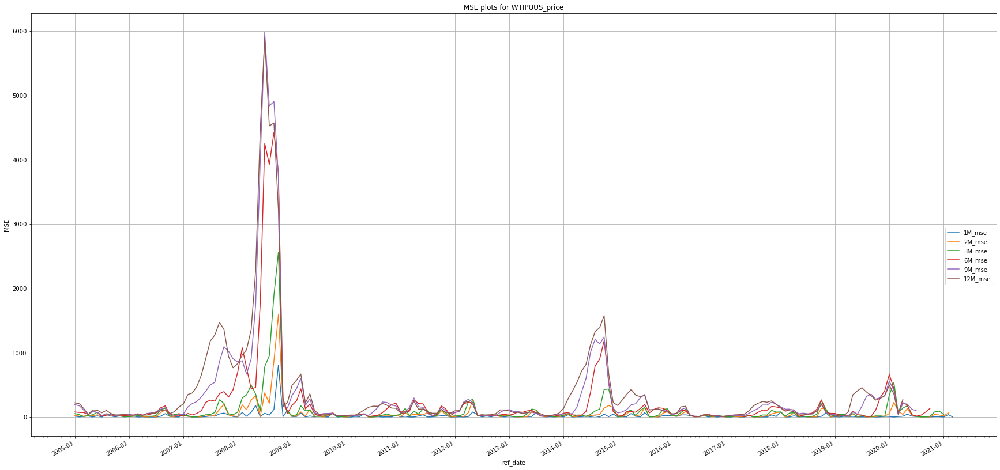

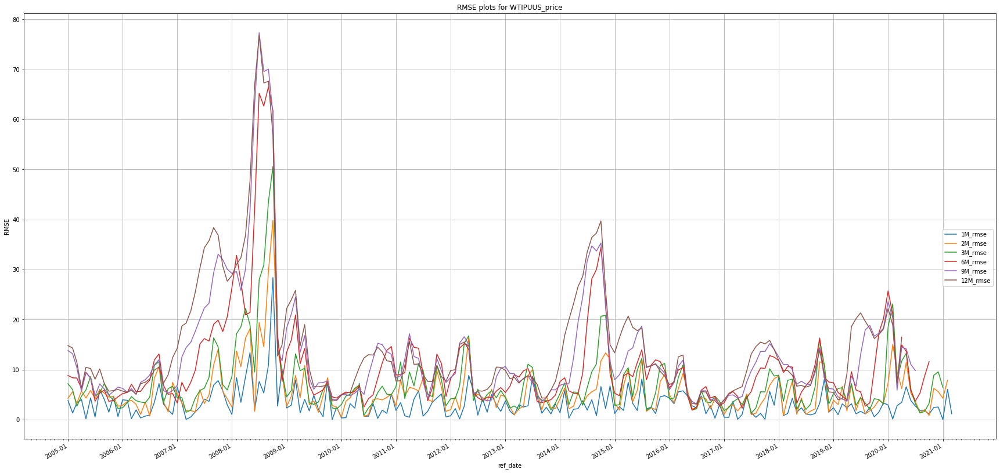

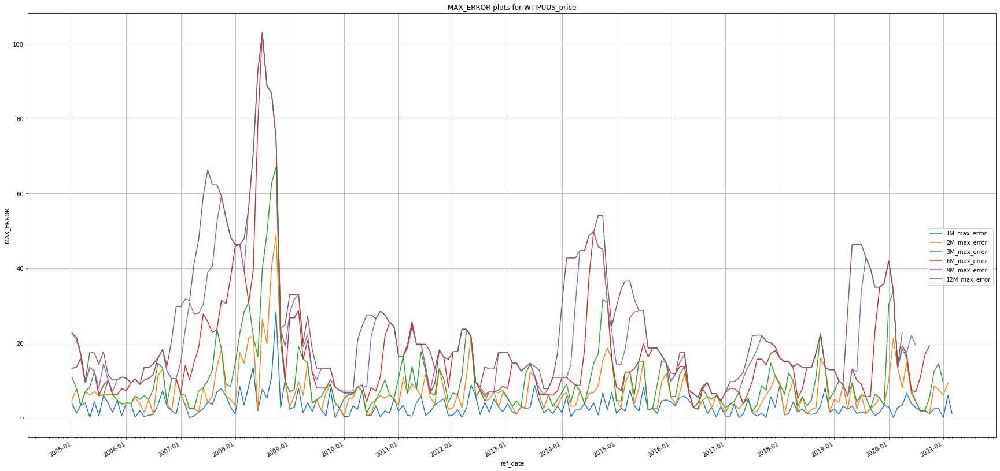




Plotting Evaluations for WTIPUUS_pct


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,WTIPUUS,2005-01-01,0.088238,0.007786,0.088238,0.088238,0.052289,0.004026,0.063454,0.088238,...,0.087956,0.132927,0.067438,0.006557,0.080972,0.132927,0.061480,0.005463,0.073914,0.132927
1,WTIPUUS,2005-02-01,0.028593,0.000818,0.028593,0.028593,0.081343,0.009399,0.096950,0.134093,...,0.084501,0.136928,0.065301,0.006294,0.079334,0.136928,0.064536,0.005957,0.077185,0.136928
2,WTIPUUS,2005-03-01,0.068744,0.004726,0.068744,0.068744,0.034950,0.002364,0.048616,0.068744,...,0.080620,0.134674,0.059244,0.005024,0.070877,0.134674,0.059711,0.004995,0.070673,0.134674
3,WTIPUUS,2005-04-01,0.074020,0.005479,0.074020,0.074020,0.065422,0.004354,0.065985,0.074020,...,0.081315,0.133483,0.062018,0.005125,0.071588,0.133483,0.061570,0.005052,0.071077,0.133483
4,WTIPUUS,2005-05-01,0.003209,0.000010,0.003209,0.003209,0.064527,0.007924,0.089015,0.125845,...,0.070386,0.125845,0.057985,0.004981,0.070577,0.125845,0.058796,0.004985,0.070608,0.125845
5,WTIPUUS,2005-06-01,0.087297,0.007621,0.087297,0.087297,0.067162,0.004916,0.070115,0.087297,...,0.068031,0.091910,0.063012,0.004761,0.068997,0.106573,0.060119,0.004628,0.068026,0.107673
6,WTIPUUS,2005-07-01,0.008873,0.000079,0.008873,0.008873,0.050163,0.004221,0.064971,0.091453,...,0.047787,0.092978,0.045841,0.003236,0.056882,0.110607,0.045635,0.003573,0.059775,0.116522
7,WTIPUUS,2005-08-01,0.102235,0.010452,0.102235,0.102235,0.054479,0.005397,0.073462,0.103761,...,0.068355,0.112442,0.058778,0.005017,0.070834,0.118381,0.049050,0.003901,0.062460,0.118381
8,WTIPUUS,2005-09-01,0.063187,0.003993,0.063187,0.063187,0.049435,0.002633,0.051312,0.063187,...,0.068817,0.124542,0.060176,0.004989,0.070634,0.124542,0.051929,0.004001,0.063256,0.124542
9,WTIPUUS,2005-10-01,0.022717,0.000516,0.022717,0.022717,0.048882,0.003074,0.055445,0.075048,...,0.055403,0.098140,0.045503,0.003550,0.059582,0.115516,0.051560,0.004419,0.066478,0.134228


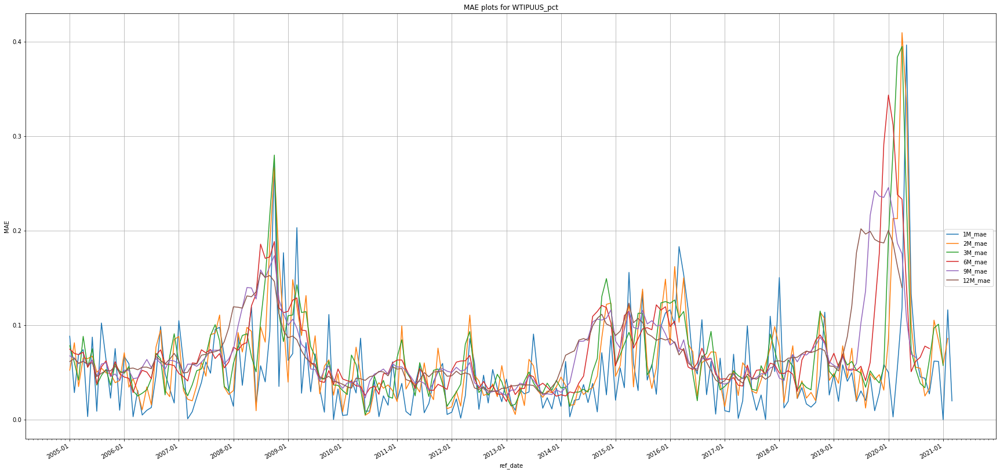

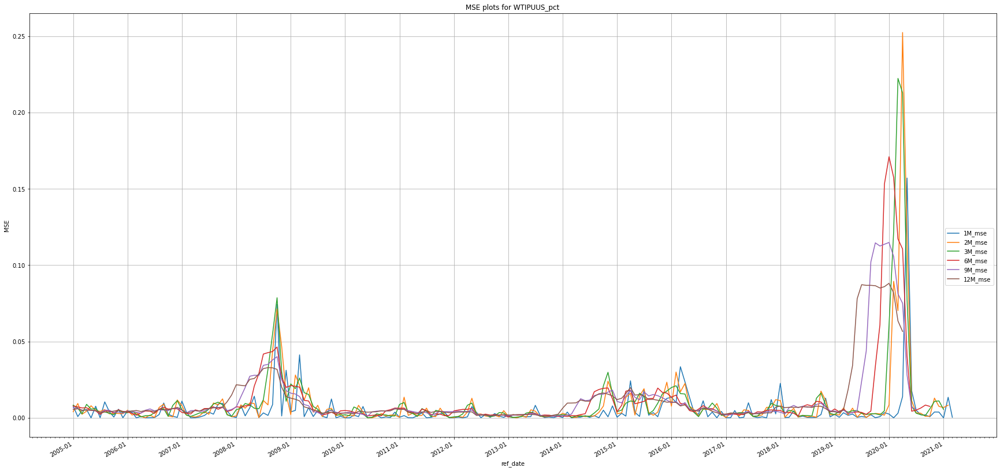

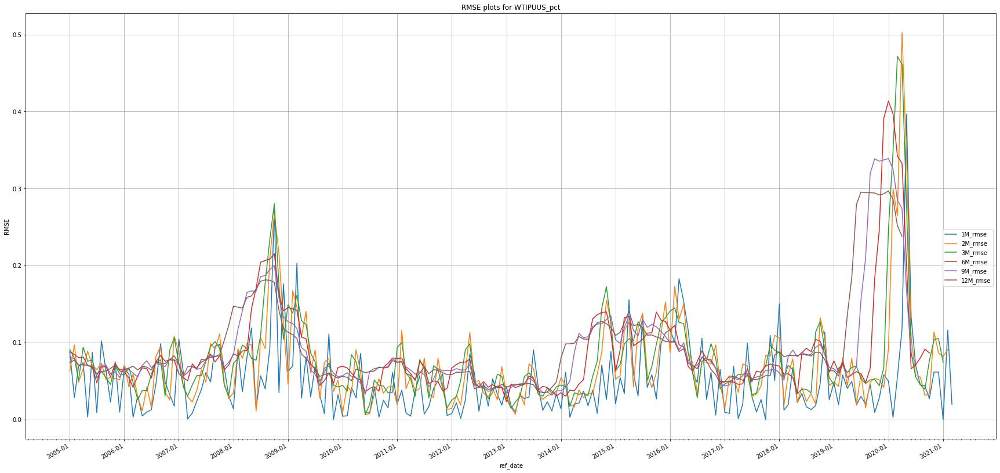

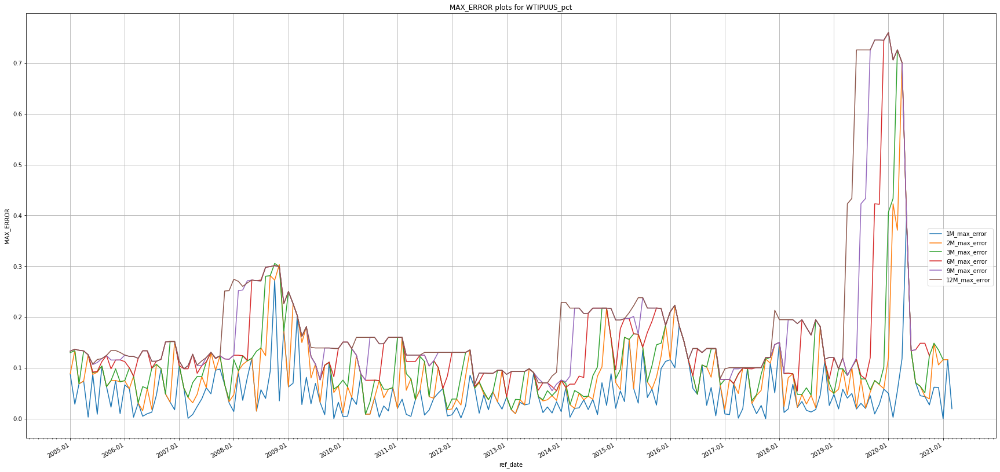




Plotting Evaluations for BREPUUS_price


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,BREPUUS,2012-07-01,3.62000,13.104400,3.62000,3.62000,8.990000,109.657000,10.471724,14.36000,...,11.288840,14.36,12.120097,163.217004,12.775641,18.5200,10.226739,127.502736,11.291711,18.52
1,BREPUUS,2012-08-01,8.36000,69.889600,8.36000,8.36000,9.110000,83.554600,9.140821,9.86000,...,9.601731,13.46,9.346763,101.288135,10.064201,16.5200,8.093406,81.985452,9.054582,16.55
2,BREPUUS,2012-09-01,0.14000,0.019600,0.14000,0.14000,0.214565,0.051598,0.227152,0.28913,...,5.180310,11.02,2.937681,21.298966,4.615080,11.0200,3.234928,22.713975,4.765918,11.05
3,BREPUUS,2012-10-01,0.28913,0.083596,0.28913,0.28913,1.114565,1.923598,1.386938,1.94000,...,5.655494,11.02,2.931014,21.297500,4.614921,11.0200,3.897969,28.175117,5.308024,11.05
4,BREPUUS,2012-11-01,0.06000,0.003600,0.06000,0.06000,0.245000,0.094250,0.307002,0.43000,...,5.592166,11.02,3.192222,23.130678,4.809436,11.0500,4.306875,32.027299,5.659267,11.05
5,BREPUUS,2012-12-01,0.93000,0.864900,0.93000,0.93000,2.945000,12.733250,3.568368,4.96000,...,4.943074,10.02,3.661111,23.974544,4.896381,10.0500,4.451042,29.755966,5.454903,10.05
6,BREPUUS,2013-01-01,1.96000,3.841600,1.96000,1.96000,4.490000,26.561000,5.153737,7.02000,...,3.642925,7.02,4.061833,22.148624,4.706232,7.5965,4.848542,29.972424,5.474708,8.76
7,BREPUUS,2013-02-01,0.02000,0.000400,0.02000,0.02000,3.230000,20.737000,4.553790,6.44000,...,6.327596,10.75,4.636944,31.286532,5.593437,10.7500,4.616875,29.336241,5.416294,10.75
8,BREPUUS,2013-03-01,1.44000,2.073600,1.44000,1.44000,4.140000,23.951700,4.894047,6.75000,...,4.198545,6.75,3.608056,16.015599,4.001949,6.7500,4.104375,20.135199,4.487226,6.76
9,BREPUUS,2013-04-01,6.75000,45.562500,6.75000,6.75000,6.095000,37.578050,6.130094,6.75000,...,4.692434,6.75,4.522500,23.198788,4.816512,6.7600,4.600208,23.386991,4.836010,6.76


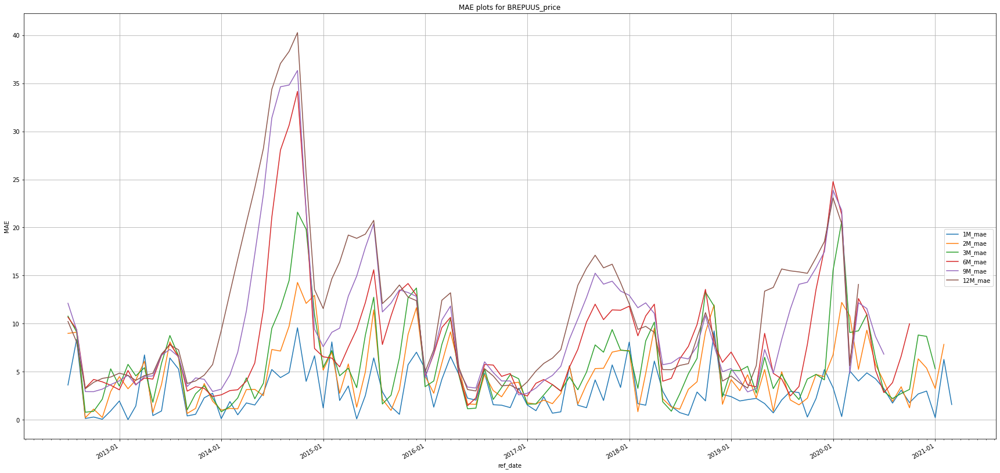

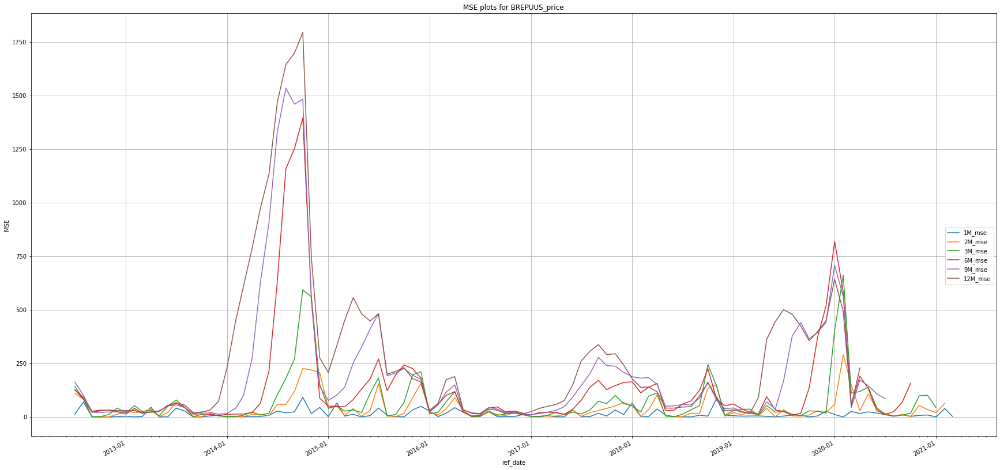

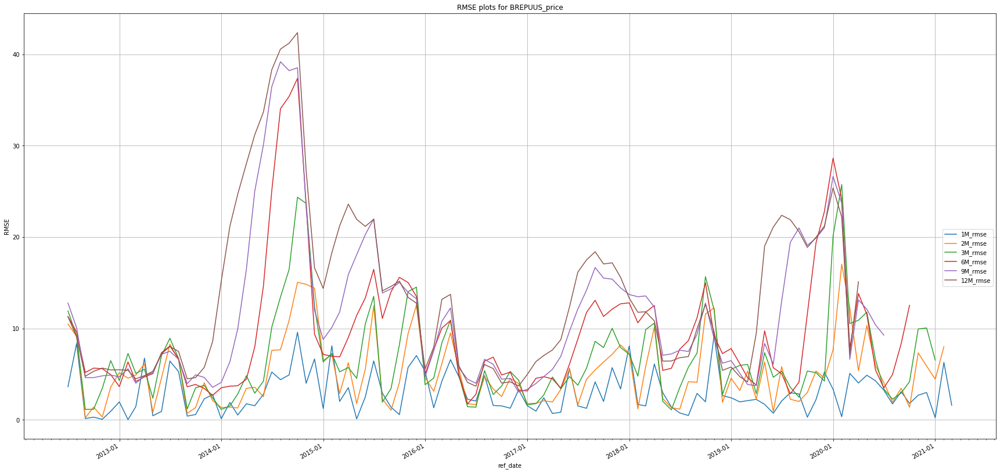

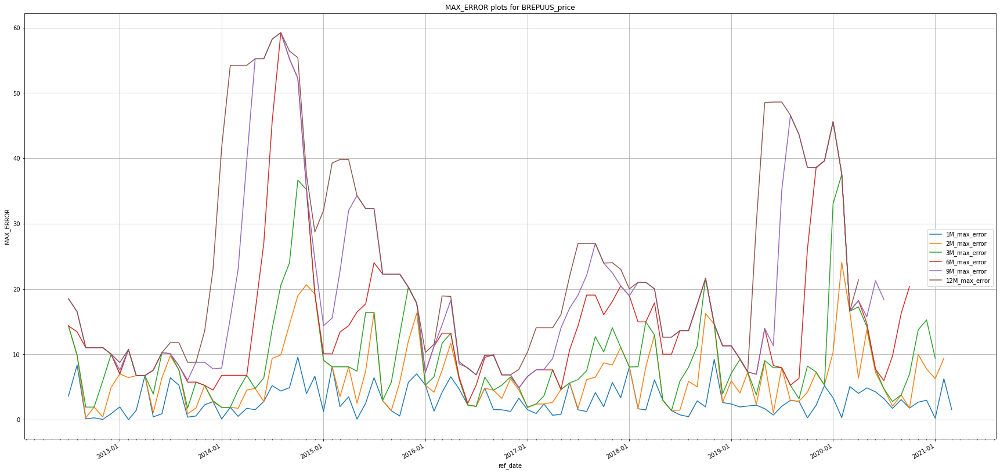




Plotting Evaluations for BREPUUS_pct


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,BREPUUS,2012-07-01,0.038041,1.447132e-03,0.038041,0.038041,0.071350,0.006200,0.078741,0.104658,...,0.047239,0.104658,0.037171,0.002333,0.048303,0.104658,0.033694,0.002085,0.045665,0.104658
1,BREPUUS,2012-08-01,0.081466,6.636644e-03,0.081466,0.081466,0.048051,0.003425,0.058527,0.081466,...,0.040386,0.081466,0.036143,0.002072,0.045515,0.081466,0.031334,0.001714,0.041398,0.081466
2,BREPUUS,2012-09-01,0.001235,1.525234e-06,0.001235,0.001235,0.001284,0.000002,0.001285,0.001332,...,0.029826,0.050607,0.026841,0.001195,0.034567,0.057343,0.026703,0.001139,0.033744,0.057343
3,BREPUUS,2012-10-01,0.002562,6.563077e-06,0.002562,0.002562,0.008682,0.000113,0.010622,0.014801,...,0.035092,0.050607,0.027230,0.001197,0.034592,0.057343,0.026939,0.001140,0.033758,0.057343
4,BREPUUS,2012-11-01,0.000537,2.884773e-07,0.000537,0.000537,0.001965,0.000006,0.002429,0.003393,...,0.040979,0.057343,0.028283,0.001335,0.036532,0.057343,0.024710,0.001087,0.032975,0.057343
5,BREPUUS,2012-12-01,0.008527,7.271683e-05,0.008527,0.008527,0.022697,0.000716,0.026757,0.036866,...,0.036364,0.047728,0.029109,0.001160,0.034064,0.047728,0.023331,0.000883,0.029723,0.047728
6,BREPUUS,2013-01-01,0.017911,3.208037e-04,0.017911,0.017911,0.031509,0.001178,0.034318,0.045107,...,0.034182,0.047997,0.029527,0.001229,0.035056,0.048679,0.025704,0.000997,0.031583,0.048679
7,BREPUUS,2013-02-01,0.000177,3.134806e-08,0.000177,0.000177,0.027928,0.001550,0.039371,0.055679,...,0.039819,0.057938,0.028149,0.001145,0.033839,0.057938,0.026384,0.001021,0.031956,0.057938
8,BREPUUS,2013-03-01,0.012412,1.540491e-04,0.012412,0.012412,0.030720,0.001251,0.035371,0.048252,...,0.030716,0.048679,0.020525,0.000665,0.025794,0.048679,0.021872,0.000685,0.026163,0.048679
9,BREPUUS,2013-04-01,0.061396,3.769481e-03,0.061396,0.061396,0.036801,0.001959,0.044263,0.061396,...,0.035172,0.061396,0.022516,0.000911,0.030189,0.061396,0.021363,0.000769,0.027724,0.061396


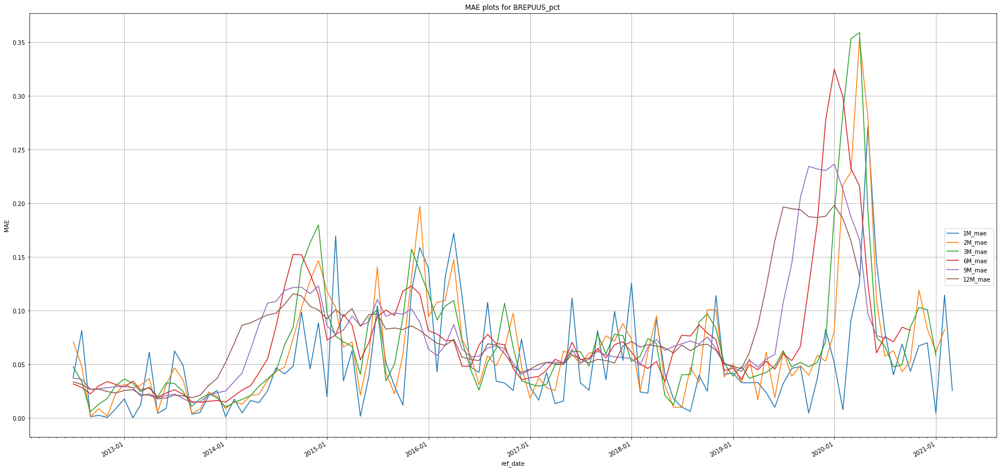

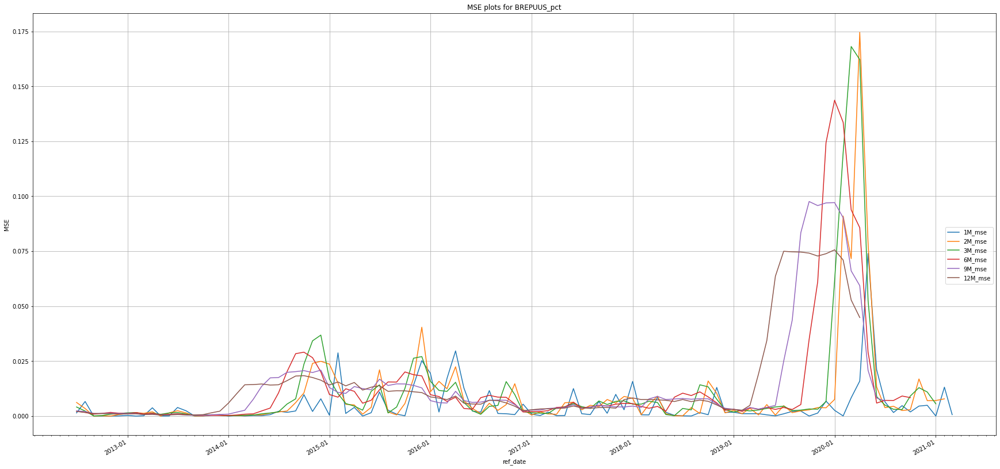

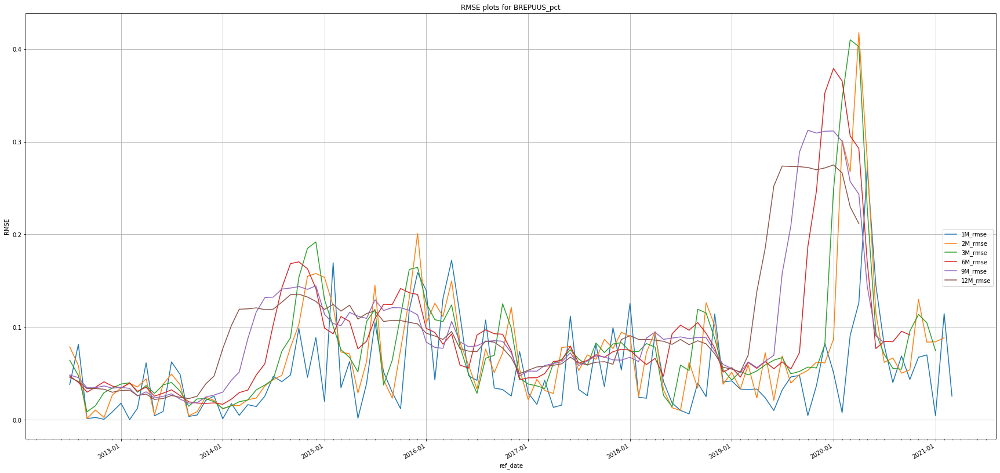

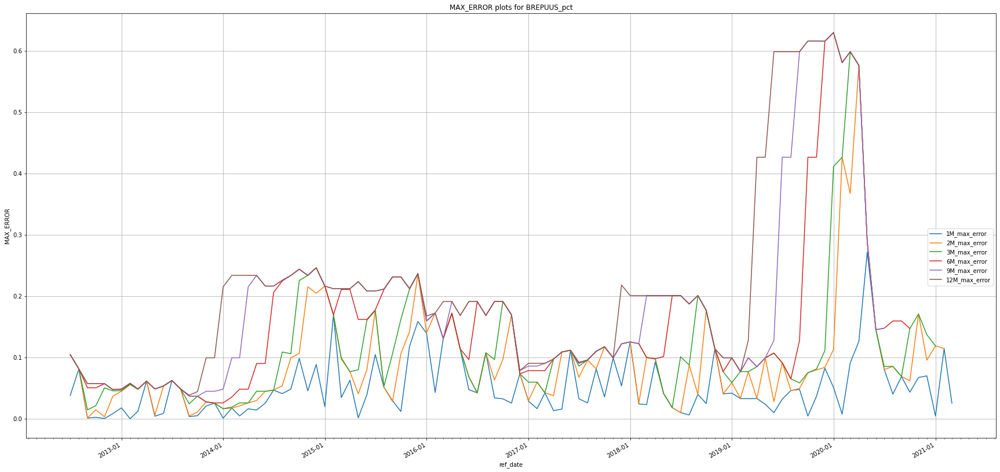




Plotting Evaluations for MGWHUUS_price


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,MGWHUUS,2005-01-01,4.949112,24.493709,4.949112,4.949112,10.890663,134.192088,11.584131,14.838516,...,20.343205,31.143494,34.991379,2171.589082,46.600312,102.596497,38.248711,2181.994681,46.711826,98.396500
1,MGWHUUS,2005-02-01,0.795715,0.633163,0.795715,0.795715,6.452446,54.053026,7.352076,9.976501,...,18.099512,27.254562,35.294573,2042.344736,45.192308,96.303009,37.876306,2050.460425,45.282010,92.103012
2,MGWHUUS,2005-03-01,5.813217,33.793494,5.813217,5.813217,7.103951,64.741875,8.046234,10.882278,...,20.072512,43.413712,27.694928,1382.706337,37.184759,81.418091,29.612606,1375.360443,37.085852,81.418091
3,MGWHUUS,2005-04-01,24.885696,619.297886,24.885696,24.885696,15.565613,273.423530,16.535523,21.145508,...,33.230833,69.849594,21.130819,820.189503,28.638951,65.649597,20.091417,718.737285,26.809276,65.649597
4,MGWHUUS,2005-05-01,4.376114,19.150373,4.376114,4.376114,11.339012,129.706760,11.388888,12.403702,...,42.843703,79.211685,31.766091,1412.294227,37.580503,75.011688,32.383841,1455.847836,38.155574,75.011688
5,MGWHUUS,2005-06-01,7.038803,49.544749,7.038803,7.038803,11.149841,125.553367,11.205060,12.260880,...,37.960798,69.670502,27.468079,1138.703041,33.744674,69.670502,32.058551,1453.084345,38.119343,69.670502
6,MGWHUUS,2005-07-01,7.403122,54.806215,7.403122,7.403122,13.161804,206.658764,14.375631,18.943298,...,23.581356,46.584702,15.220101,445.345549,21.103212,46.584702,24.386222,980.977095,31.320554,50.656097
7,MGWHUUS,2005-08-01,18.192810,330.978338,18.192810,18.192810,39.291901,1711.509246,41.370391,52.240097,...,27.394716,48.040100,24.329954,893.490359,29.891309,54.257813,33.381397,1605.412072,40.067594,68.614426
8,MGWHUUS,2005-09-01,10.543518,111.165773,10.543518,10.543518,12.086205,148.456221,12.184261,13.628891,...,18.266944,32.724594,18.626012,482.231914,21.959779,34.595612,27.201614,1069.138972,32.697691,64.242020
9,MGWHUUS,2005-10-01,26.446716,699.428804,26.446716,26.446716,35.901268,1378.289592,37.125323,45.355820,...,25.813586,44.055801,24.207431,737.298150,27.153235,44.055801,27.697760,998.971213,31.606506,55.126816


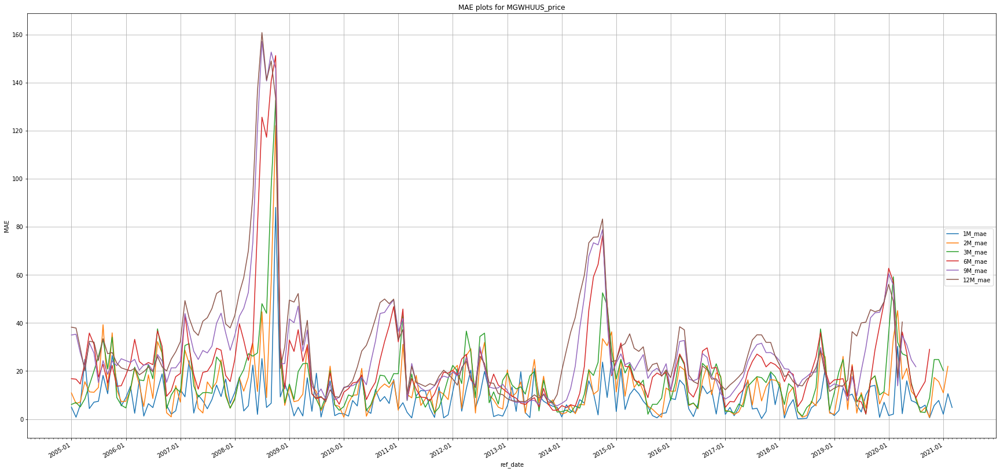

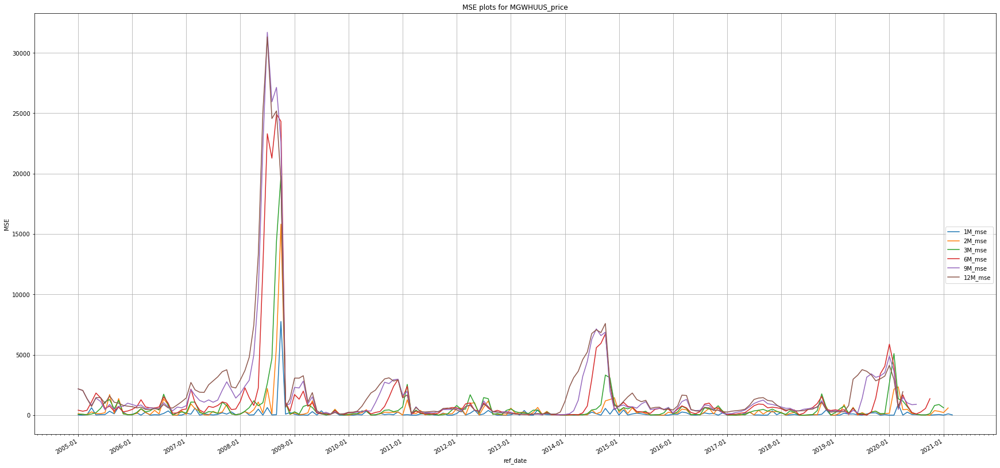

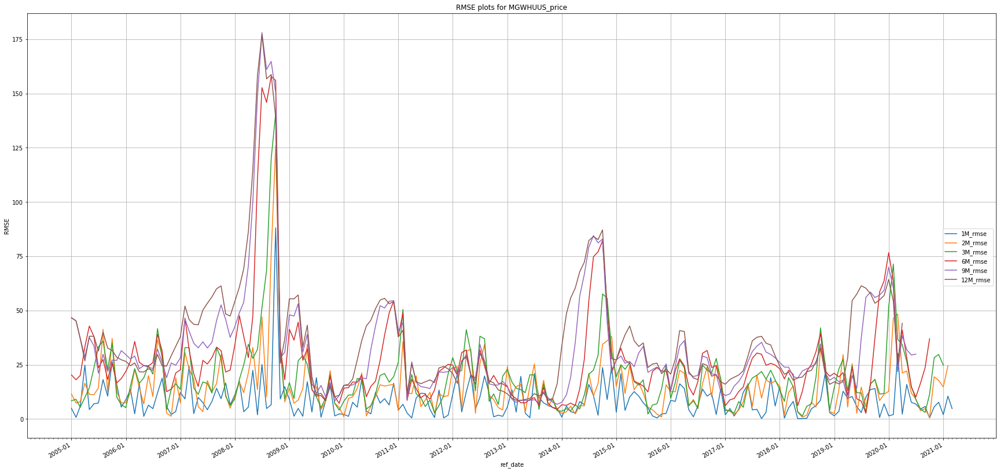

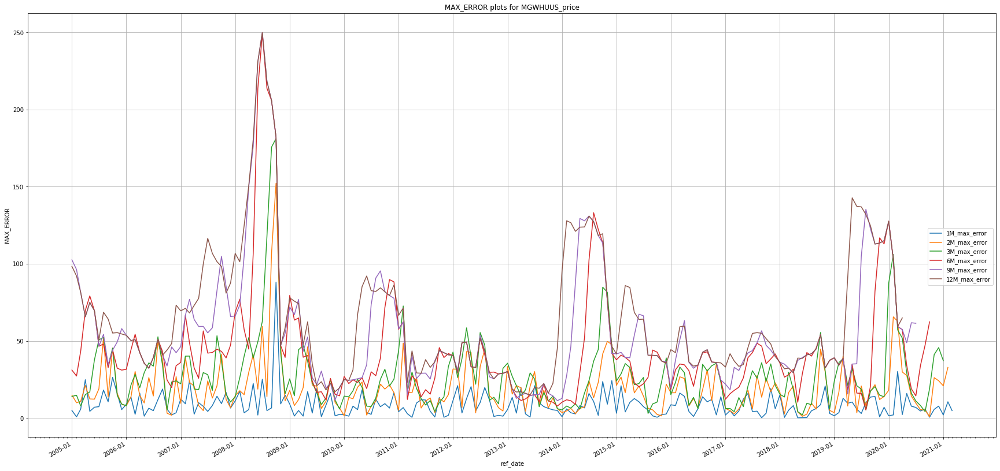




Plotting Evaluations for MGWHUUS_pct


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,MGWHUUS,2005-01-01,0.114348,0.013076,0.114348,0.114348,0.089272,0.008986,0.094794,0.121153,...,0.084032,0.144403,0.100661,0.012667,0.112548,0.188228,0.100678,0.012581,0.112167,0.181854
1,MGWHUUS,2005-02-01,0.010069,0.000101,0.010069,0.010069,0.064237,0.005001,0.070719,0.093813,...,0.092609,0.163978,0.120032,0.017475,0.132194,0.203921,0.102993,0.012723,0.112797,0.182427
2,MGWHUUS,2005-03-01,0.039099,0.001529,0.039099,0.039099,0.074500,0.006098,0.078088,0.097898,...,0.098429,0.165892,0.113083,0.014572,0.120717,0.178158,0.097797,0.011462,0.107058,0.178158
3,MGWHUUS,2005-04-01,0.189557,0.035932,0.189557,0.189557,0.102040,0.011437,0.106943,0.134050,...,0.116988,0.172678,0.109021,0.013413,0.115816,0.166304,0.090102,0.010422,0.102086,0.176633
4,MGWHUUS,2005-05-01,0.068451,0.004685,0.068451,0.068451,0.044104,0.002947,0.054282,0.075749,...,0.119759,0.178109,0.092705,0.011066,0.105194,0.173929,0.091998,0.010917,0.104483,0.173929
5,MGWHUUS,2005-06-01,0.006391,0.000041,0.006391,0.006391,0.021165,0.000502,0.022413,0.028539,...,0.120789,0.149115,0.089115,0.010583,0.102871,0.173489,0.085987,0.010290,0.101442,0.173489
6,MGWHUUS,2005-07-01,0.065447,0.004283,0.065447,0.065447,0.112565,0.014904,0.122084,0.159824,...,0.105394,0.145426,0.074878,0.007954,0.089184,0.158532,0.076173,0.008915,0.094421,0.159588
7,MGWHUUS,2005-08-01,0.110481,0.012206,0.110481,0.110481,0.120593,0.014630,0.120954,0.129934,...,0.101886,0.152950,0.094837,0.010345,0.101710,0.152950,0.076645,0.007929,0.089043,0.152950
8,MGWHUUS,2005-09-01,0.104324,0.010884,0.104324,0.104324,0.054633,0.004180,0.064652,0.089204,...,0.094675,0.135455,0.083003,0.009059,0.095178,0.141255,0.081063,0.008283,0.091010,0.144875
9,MGWHUUS,2005-10-01,0.117541,0.013816,0.117541,0.117541,0.104388,0.010905,0.104428,0.107297,...,0.088455,0.132057,0.080506,0.009108,0.095435,0.152022,0.092460,0.011877,0.108983,0.221511


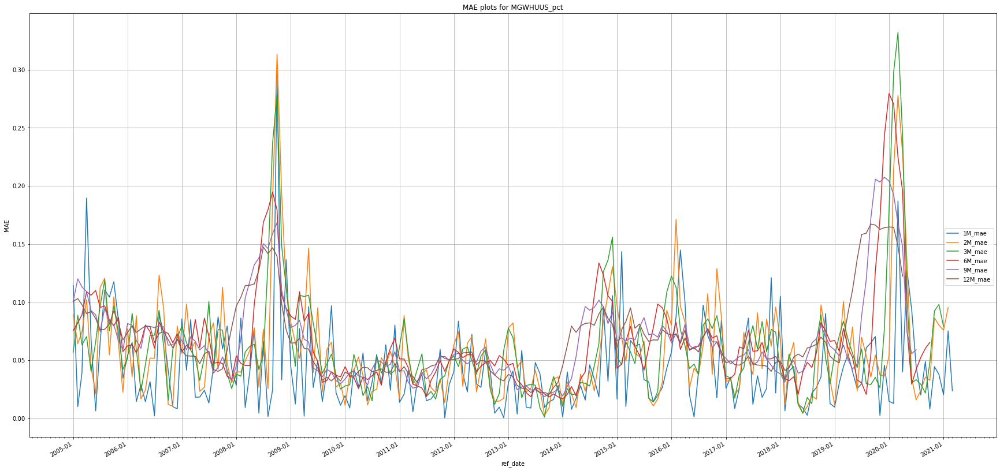

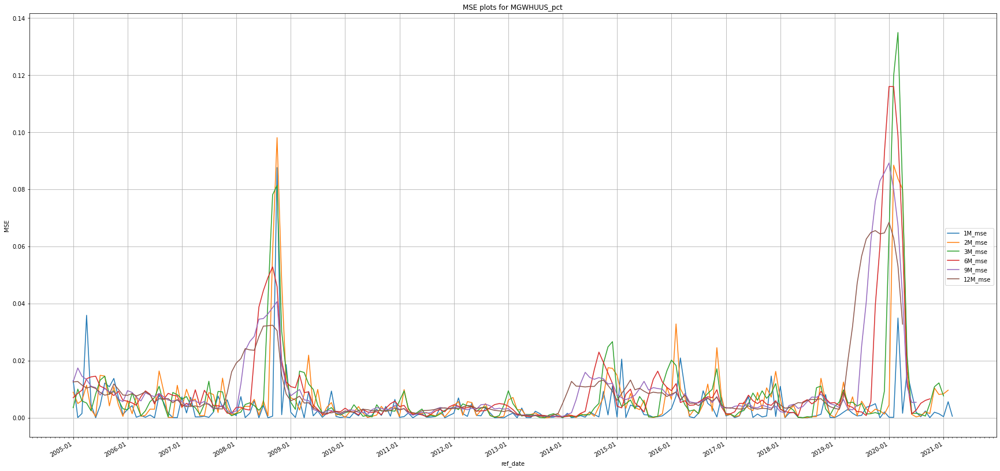

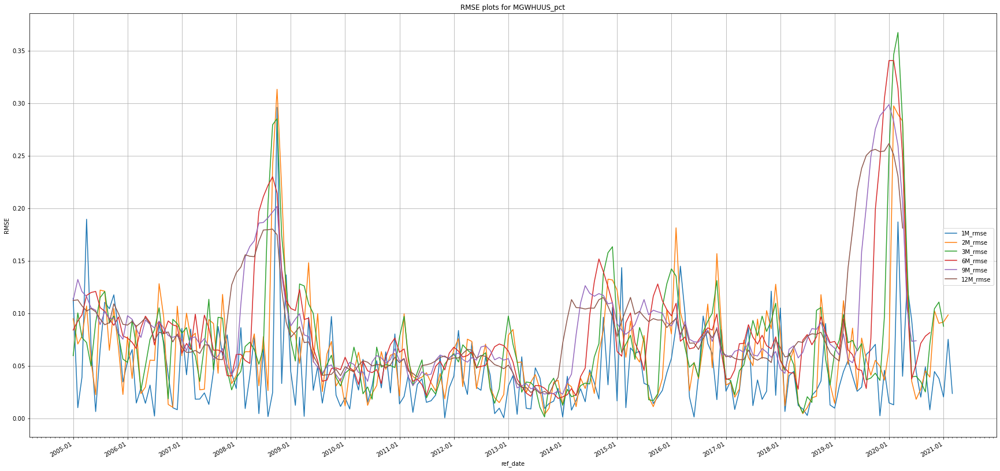

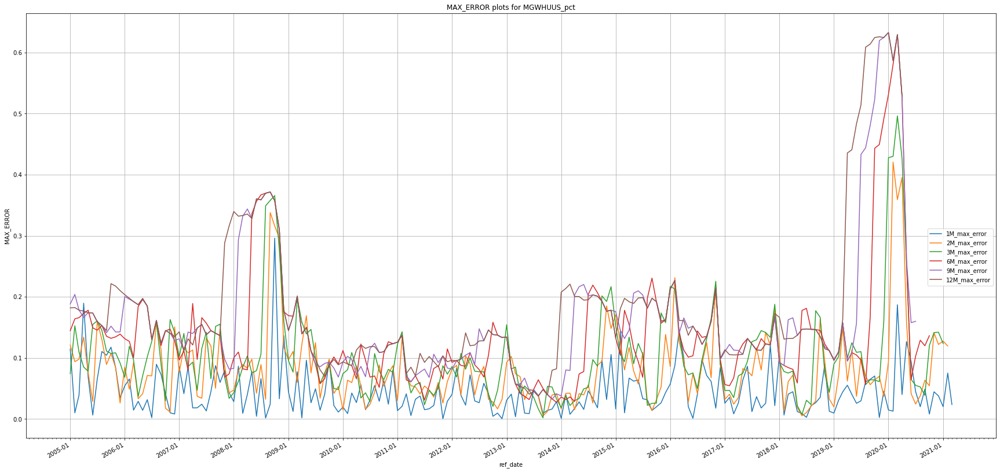




Plotting Evaluations for DSWHUUS_price


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,DSWHUUS,2007-10-01,15.2662,233.056862,15.2662,15.2662,31.38585,1194.462609,34.560998,45.8562,...,51.004175,90.0857,75.487200,8066.865640,89.815732,160.0611,84.605375,9418.730078,97.050142,159.8769
1,DSWHUUS,2007-11-01,17.2993,299.265780,17.2993,17.2993,16.28735,266.846151,16.335426,17.5397,...,51.230977,93.0071,72.723333,7998.749163,89.435726,143.8789,69.609642,7369.754590,85.847275,149.7641
2,DSWHUUS,2007-12-01,1.8386,3.380450,1.8386,1.8386,1.41465,2.123490,1.457220,1.7643,...,61.647275,113.8345,65.705278,6604.576276,81.268544,127.7321,62.919858,6044.868938,77.748755,136.0274
3,DSWHUUS,2008-01-01,12.6284,159.476487,12.6284,12.6284,10.13345,112.517856,10.607443,13.2689,...,77.005544,127.9137,68.671511,6520.896345,80.752067,129.5708,69.847742,6422.850974,80.142691,129.7708
4,DSWHUUS,2008-02-01,28.7420,826.102564,28.7420,28.7420,44.85415,2246.356710,47.395746,60.1663,...,95.612926,129.5477,76.624556,7423.281010,86.158465,135.4329,74.832517,6903.191181,83.085445,135.4329
5,DSWHUUS,2008-03-01,9.8580,97.180164,9.8580,9.8580,27.47245,1090.187555,33.017988,45.7878,...,75.446101,108.6149,64.859756,5260.196374,72.527211,117.3595,71.303083,6329.111347,79.555712,117.3595
6,DSWHUUS,2008-04-01,28.4449,809.112336,28.4449,28.4449,46.93120,2574.633917,50.740851,66.2210,...,61.094572,93.6272,72.062100,6383.574424,79.897274,138.4222,81.137258,8223.097198,90.681295,138.2539
7,DSWHUUS,2008-05-01,34.0134,1156.911380,34.0134,34.0134,42.37670,1853.663324,43.054191,49.9845,...,54.395606,106.2991,74.348589,8611.662846,92.799046,166.0597,98.458883,13730.098141,117.175501,174.0647
8,DSWHUUS,2008-06-01,11.3878,129.681989,11.3878,11.3878,17.90200,329.843368,18.161590,20.9617,...,113.602386,202.3767,131.650367,24470.775906,156.431378,232.8223,157.014725,31958.680817,178.769910,241.5813
9,DSWHUUS,2008-07-01,16.2236,263.205197,16.2236,16.2236,49.97465,3451.759682,58.751678,80.8663,...,165.798741,258.0364,169.301522,36522.729480,191.109208,257.3841,182.887358,40010.044629,200.025110,258.0608


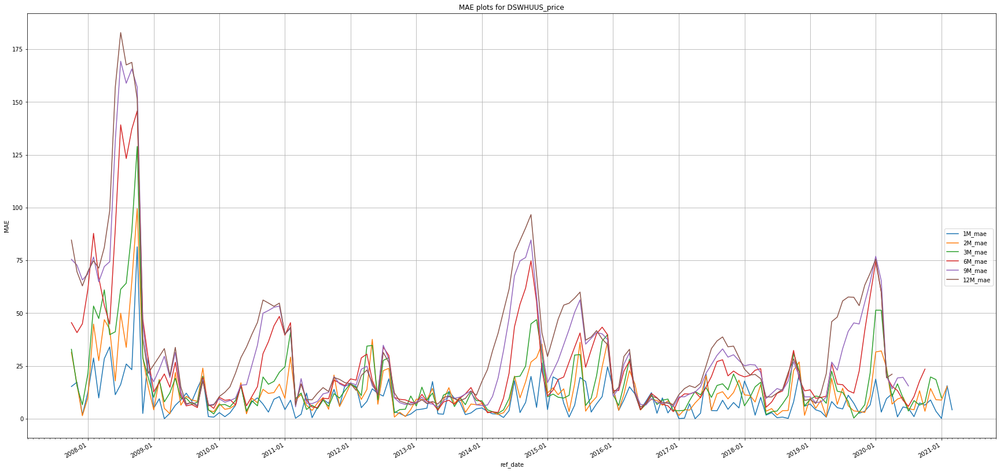

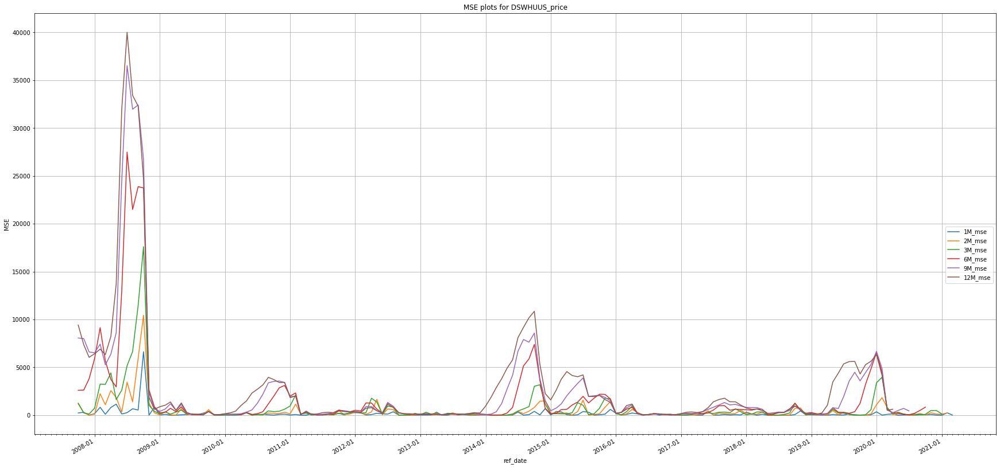

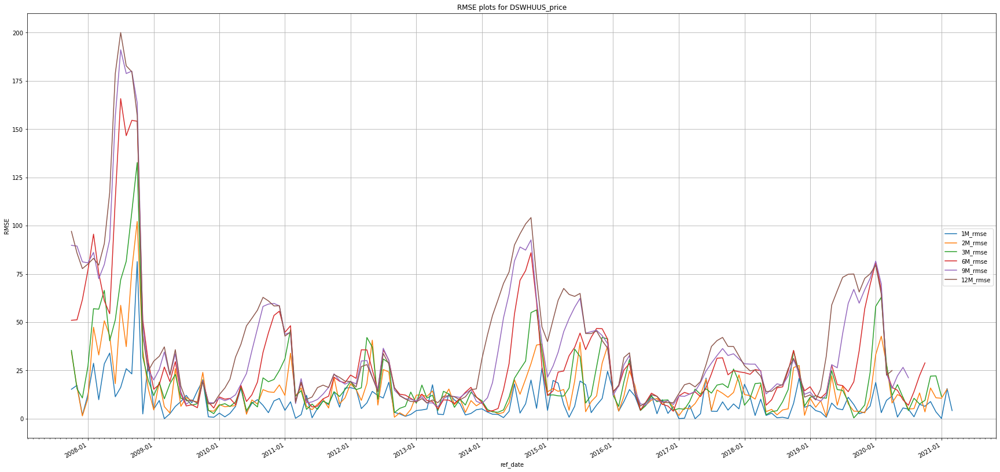

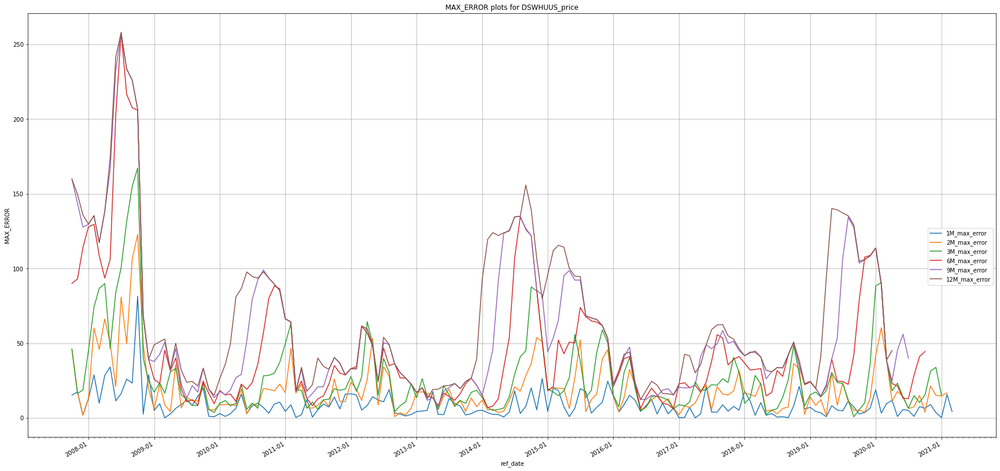




Plotting Evaluations for DSWHUUS_pct


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,DSWHUUS,2007-10-01,0.069743,0.004864,0.069743,0.069743,0.092529,0.009273,0.096296,0.119199,...,0.084473,0.134751,0.069894,0.006782,0.082355,0.150587,0.070630,0.006907,0.083110,0.150587
1,DSWHUUS,2007-11-01,0.063752,0.004064,0.063752,0.063752,0.040210,0.002699,0.051948,0.073100,...,0.075659,0.148513,0.056941,0.005243,0.072405,0.153998,0.082054,0.011081,0.105265,0.251488
2,DSWHUUS,2007-12-01,0.005934,0.000035,0.005934,0.005934,0.006362,0.000055,0.007388,0.010118,...,0.084013,0.157287,0.063933,0.007066,0.084057,0.157287,0.089528,0.013931,0.118028,0.263351
3,DSWHUUS,2008-01-01,0.048100,0.002314,0.048100,0.048100,0.062667,0.004186,0.064697,0.078745,...,0.093648,0.150242,0.078755,0.008059,0.089773,0.150242,0.112148,0.019212,0.138609,0.313655
4,DSWHUUS,2008-02-01,0.114327,0.013071,0.114327,0.114327,0.109432,0.011980,0.109452,0.111534,...,0.083602,0.123167,0.099138,0.013605,0.116641,0.239788,0.110235,0.016547,0.128634,0.222543
5,DSWHUUS,2008-03-01,0.032407,0.001050,0.032407,0.032407,0.080252,0.007846,0.088579,0.117747,...,0.095669,0.150765,0.112079,0.017672,0.132937,0.259414,0.111911,0.016644,0.129013,0.224898
6,DSWHUUS,2008-04-01,0.092665,0.008587,0.092665,0.092665,0.099877,0.010197,0.100978,0.114746,...,0.088952,0.142265,0.125418,0.022746,0.150816,0.300841,0.105278,0.015939,0.126251,0.240115
7,DSWHUUS,2008-05-01,0.103248,0.010660,0.103248,0.103248,0.075484,0.006915,0.083154,0.110367,...,0.126889,0.243791,0.112740,0.017947,0.133968,0.214074,0.101811,0.015127,0.122993,0.219890
8,DSWHUUS,2008-06-01,0.032506,0.001057,0.032506,0.032506,0.023091,0.000587,0.024238,0.030459,...,0.144655,0.255890,0.108649,0.018526,0.136111,0.232428,0.098771,0.015714,0.125356,0.232428
9,DSWHUUS,2008-07-01,0.032835,0.001078,0.032835,0.032835,0.100369,0.013976,0.118219,0.162833,...,0.181886,0.319807,0.113439,0.019797,0.140703,0.232380,0.117683,0.019792,0.140683,0.232380


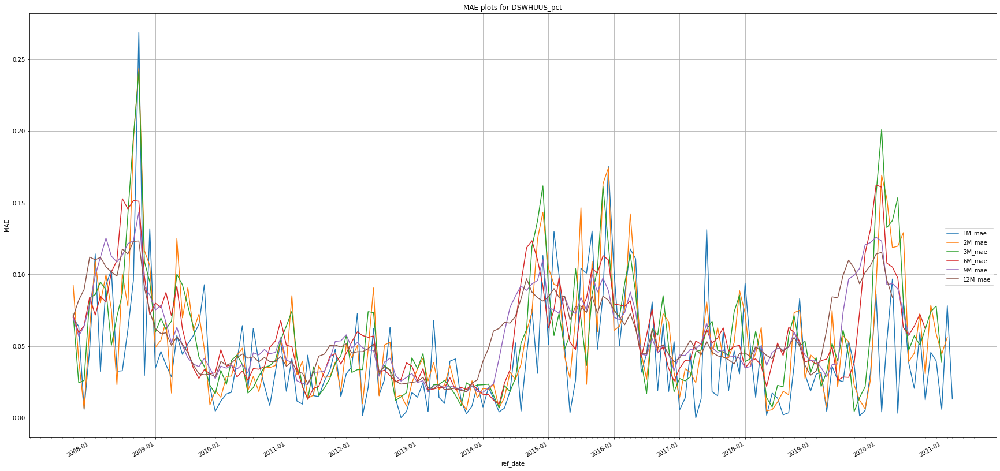

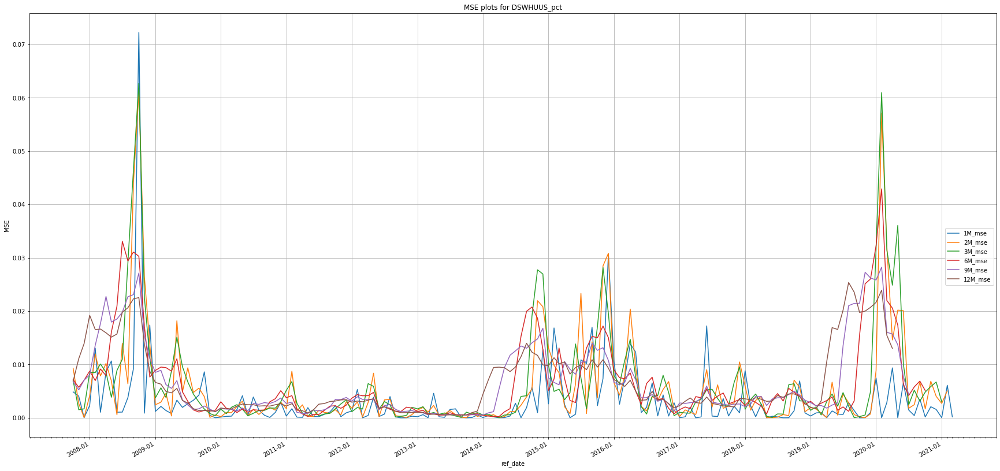

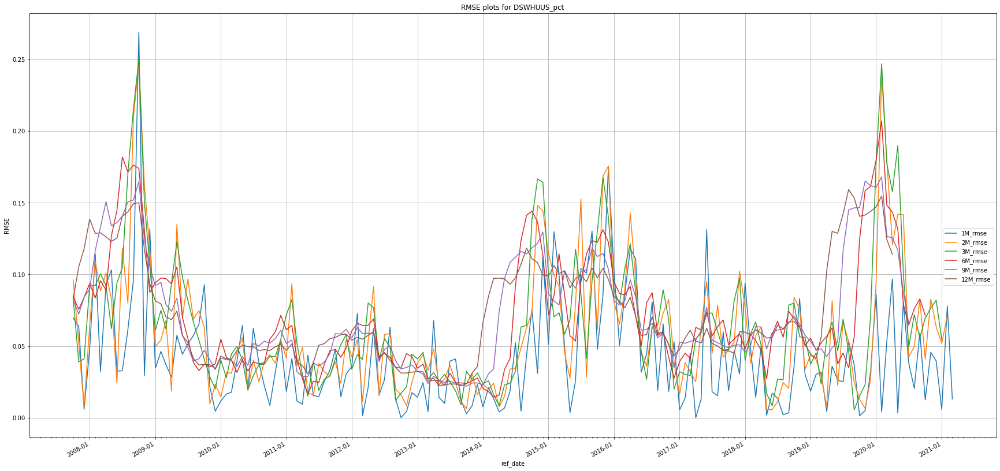

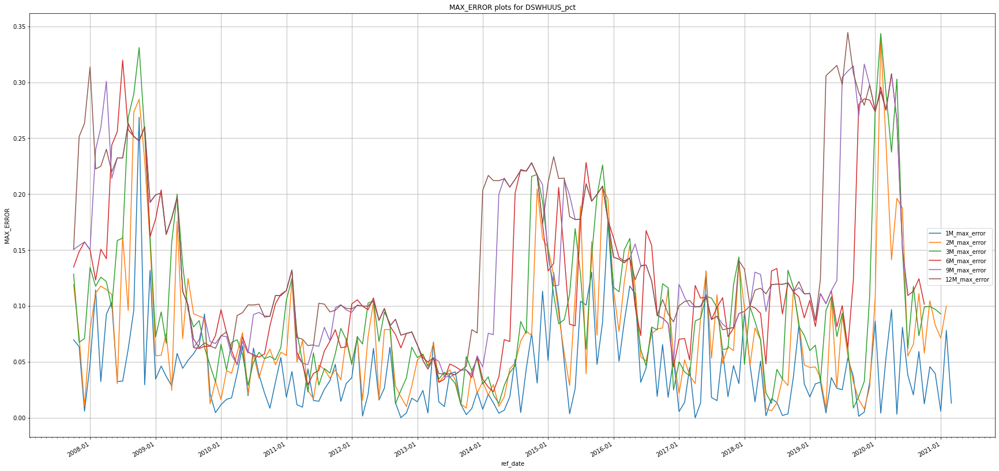




Plotting Evaluations for D2WHUUS_price


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,D2WHUUS,2005-01-01,12.983482,168.570814,12.983482,12.983482,11.275944,127.300926,11.282771,11.668396,...,31.578795,47.106606,41.124731,2204.908432,46.956453,83.642982,45.865365,2621.926641,51.204752,86.582191
1,D2WHUUS,2005-02-01,1.201096,1.442631,1.201096,1.201096,10.706360,160.461165,12.667327,17.476517,...,30.672975,47.765213,39.384905,2073.380590,45.534389,77.048203,42.288495,2250.336417,47.437711,80.463493
2,D2WHUUS,2005-03-01,9.606018,92.275583,9.606018,9.606018,0.495895,0.308313,0.555259,0.745697,...,30.735157,51.721497,36.150287,1635.994473,40.447429,66.145599,36.473784,1628.851557,40.359033,71.092987
3,D2WHUUS,2005-04-01,18.711304,350.112887,18.711304,18.711304,2.878586,8.867960,2.977912,3.641281,...,25.509381,48.915787,21.534075,737.848488,27.163367,51.940689,20.337306,626.087706,25.021745,51.940704
4,D2WHUUS,2005-05-01,19.084015,364.199624,19.084015,19.084015,26.989044,790.898236,28.122913,34.894089,...,43.951147,63.608597,39.776850,1786.582545,42.267985,63.759903,40.678491,1873.884162,43.288384,64.301407
5,D2WHUUS,2005-06-01,11.919296,142.069623,11.919296,11.919296,16.797348,290.434170,17.042129,19.675415,...,27.174443,42.809677,22.620361,664.358796,25.775159,45.720200,28.164485,1017.277856,31.894794,53.225922
6,D2WHUUS,2005-07-01,0.765717,0.586322,0.765717,0.765717,8.779114,99.282307,9.964051,13.491806,...,18.842510,35.258682,12.358336,269.455550,16.415101,35.258698,20.666496,678.759031,26.053004,44.319000
7,D2WHUUS,2005-08-01,12.500107,156.252670,12.500107,12.500107,18.446289,375.622845,19.380992,24.392487,...,17.162930,31.633209,16.851273,464.306911,21.547782,44.702911,24.818029,941.745649,30.687875,53.340118
8,D2WHUUS,2005-09-01,9.411194,88.570570,9.411194,9.411194,9.811752,96.430943,9.819926,10.212326,...,17.719660,27.736618,16.348046,368.471981,19.195624,28.349121,19.776583,506.034542,22.495212,32.863693
9,D2WHUUS,2005-10-01,7.026520,49.371980,7.026520,7.026520,13.054092,251.906672,15.871568,22.081680,...,17.990827,25.438324,16.004730,294.329498,17.156034,25.438309,16.858859,322.408243,17.955730,25.438309


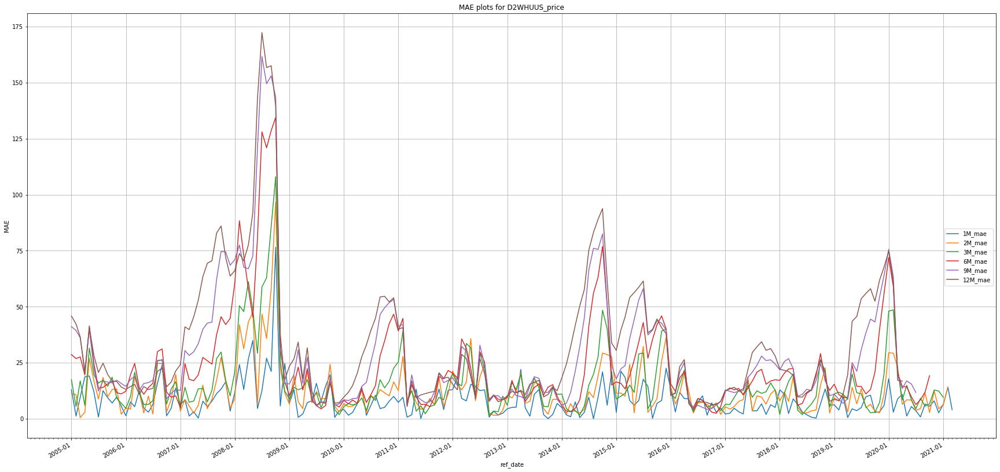

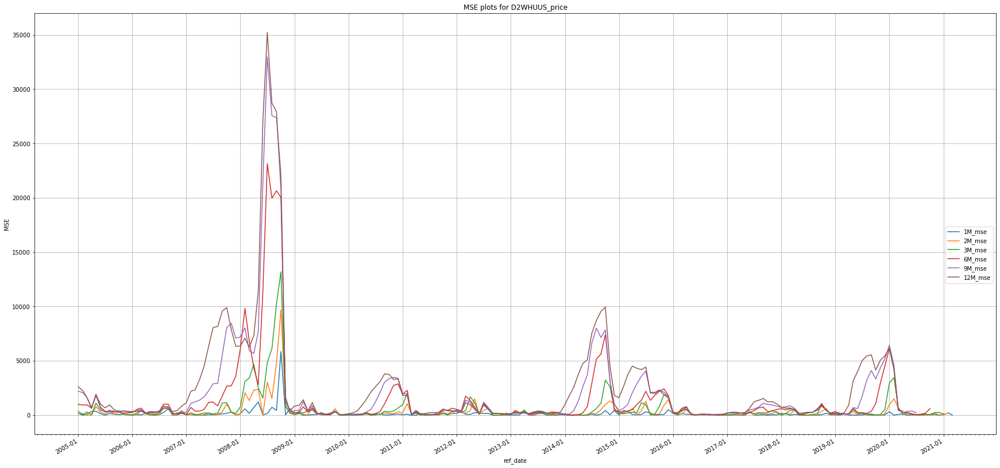

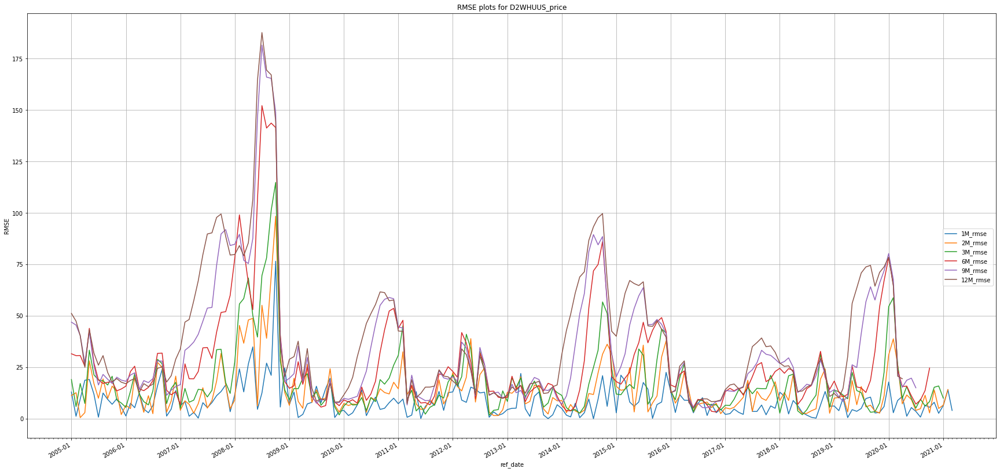

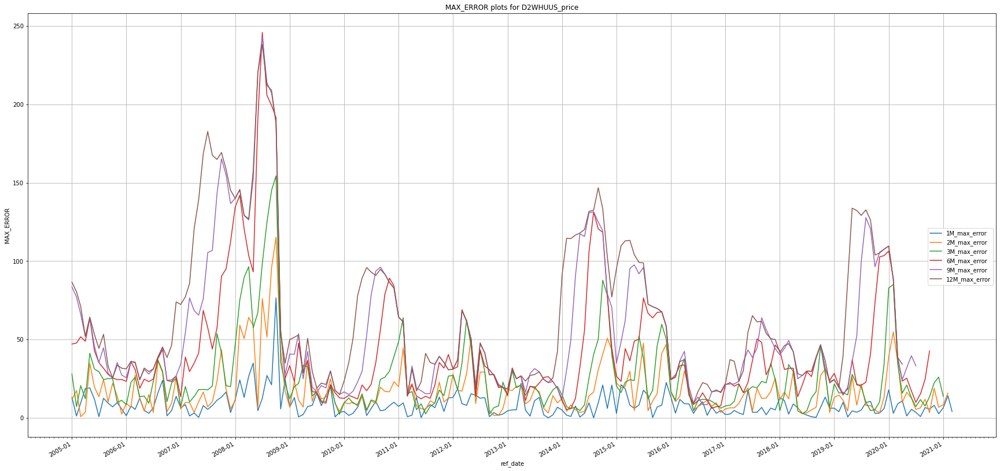




Plotting Evaluations for D2WHUUS_pct


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,D2WHUUS,2005-01-01,0.009959,0.000099,0.009959,0.009959,0.013602,0.000250,0.015804,0.021649,...,0.081976,0.159291,0.067510,0.006850,0.082766,0.159292,0.066774,0.007856,0.088632,0.183544
1,D2WHUUS,2005-02-01,0.024797,0.000615,0.024797,0.024797,0.075869,0.006334,0.079588,0.099913,...,0.095023,0.158307,0.076083,0.007680,0.087638,0.158307,0.068233,0.007692,0.087706,0.167058
2,D2WHUUS,2005-03-01,0.049757,0.002476,0.049757,0.049757,0.007765,0.000078,0.008857,0.012025,...,0.082570,0.124080,0.075278,0.006998,0.083655,0.123462,0.065303,0.006389,0.079928,0.165737
3,D2WHUUS,2005-04-01,0.057887,0.003351,0.057887,0.057887,0.030941,0.000991,0.031475,0.036716,...,0.077212,0.118392,0.067739,0.007460,0.086372,0.179907,0.057787,0.005432,0.073704,0.165330
4,D2WHUUS,2005-05-01,0.004296,0.000018,0.004296,0.004296,0.055931,0.005986,0.077369,0.109389,...,0.071793,0.120106,0.050729,0.005364,0.073241,0.157237,0.057707,0.005901,0.076816,0.158209
5,D2WHUUS,2005-06-01,0.081084,0.006575,0.081084,0.081084,0.074971,0.007195,0.084826,0.114654,...,0.075245,0.105335,0.054670,0.004951,0.070367,0.147609,0.057045,0.005307,0.072849,0.147609
6,D2WHUUS,2005-07-01,0.017620,0.000310,0.017620,0.017620,0.063031,0.005814,0.076250,0.105939,...,0.087210,0.160485,0.056458,0.005036,0.070965,0.145907,0.055956,0.005239,0.072383,0.145907
7,D2WHUUS,2005-08-01,0.095556,0.009131,0.095556,0.095556,0.081883,0.007066,0.084061,0.100897,...,0.074316,0.133399,0.067079,0.006536,0.080848,0.142160,0.055961,0.004708,0.068616,0.134370
8,D2WHUUS,2005-09-01,0.051710,0.002674,0.051710,0.051710,0.015575,0.000346,0.018605,0.025751,...,0.071144,0.134091,0.062404,0.006003,0.077478,0.135839,0.053032,0.004538,0.067368,0.134091
9,D2WHUUS,2005-10-01,0.035133,0.001234,0.035133,0.035133,0.051878,0.004343,0.065904,0.092523,...,0.062566,0.134797,0.050134,0.004510,0.067159,0.134797,0.054849,0.005720,0.075632,0.163865


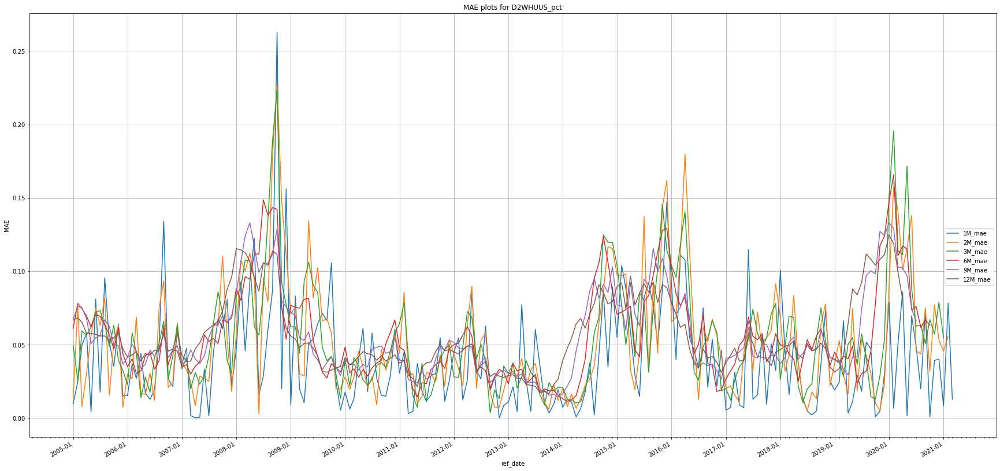

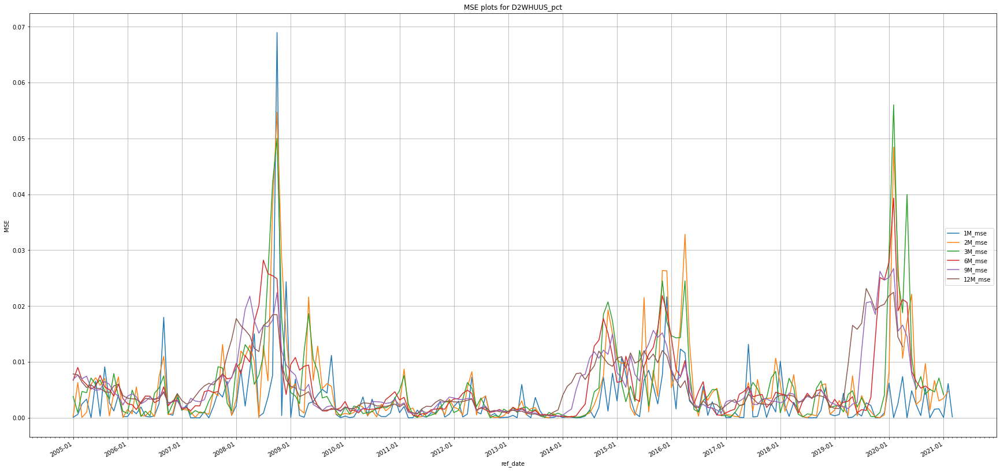

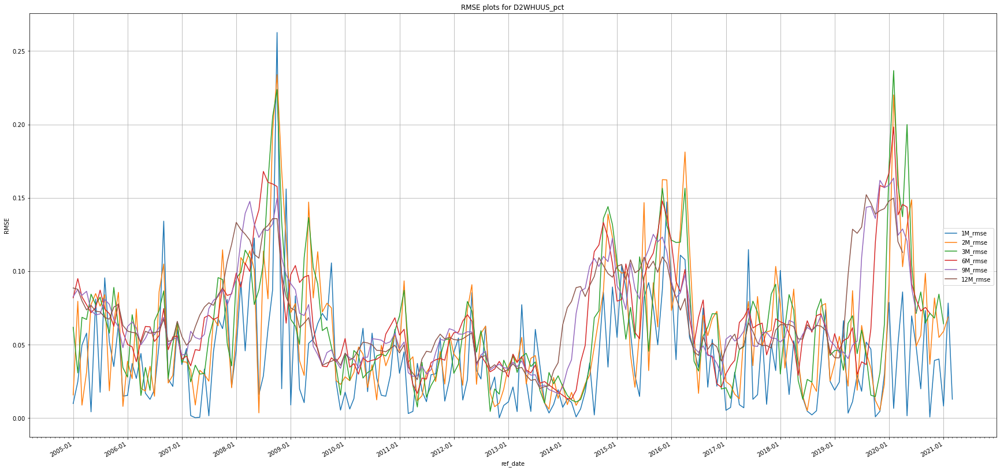

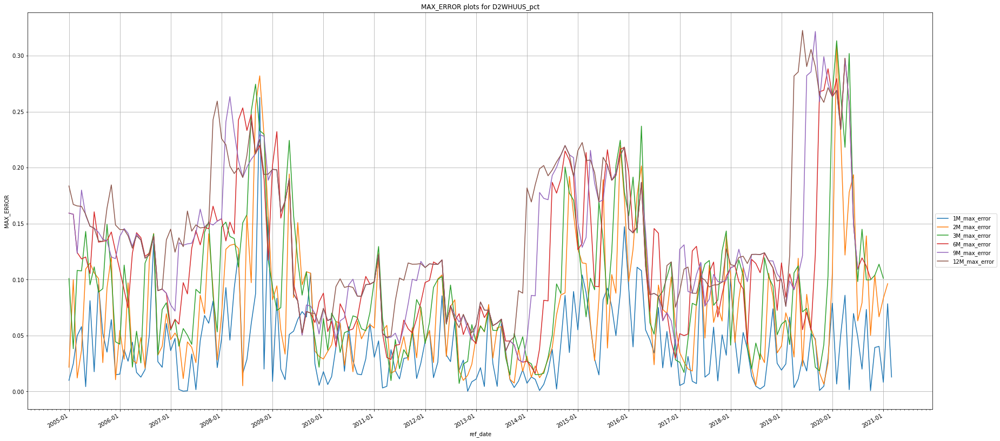




Plotting Evaluations for MGRARUS_price


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,MGRARUS,2007-10-01,0.0334,0.001116,0.0334,0.0334,16.16445,521.500218,22.836379,32.2955,...,32.120933,42.2646,43.330011,2541.969190,50.417945,98.3387,56.319217,4193.578337,64.757844,107.0154
1,MGRARUS,2007-11-01,12.5688,157.974733,12.5688,12.5688,9.84530,104.347384,10.215057,12.5688,...,21.399850,32.7473,37.551833,2205.019474,46.957635,89.3175,42.562758,2615.009357,51.137162,89.3175
2,MGRARUS,2007-12-01,0.3567,0.127235,0.3567,0.3567,3.21715,18.532228,4.304907,6.0776,...,17.695574,35.6111,31.287611,1720.289253,41.476370,76.2168,35.728483,2061.253326,45.401028,76.2168
3,MGRARUS,2008-01-01,7.7023,59.325425,7.7023,7.7023,7.99540,64.012329,8.000771,8.2885,...,28.974890,61.5232,36.250822,2070.171653,45.499139,73.5522,43.206158,2930.476914,54.133880,108.2734
4,MGRARUS,2008-02-01,7.0433,49.608075,7.0433,7.0433,12.01140,168.955748,12.998298,16.9795,...,48.098397,81.5588,43.643189,2652.900212,51.506312,81.5588,54.832500,4018.890068,63.394716,106.1140
5,MGRARUS,2008-03-01,2.1495,4.620350,2.1495,2.1495,5.04140,33.778800,5.811953,7.9333,...,43.457410,68.1482,39.645489,2425.696162,49.251357,86.7432,58.080625,5058.358196,71.122136,126.0723
6,MGRARUS,2008-04-01,0.5226,0.273111,0.5226,0.5226,8.23300,127.232557,11.279741,15.9434,...,31.069416,45.6481,49.793600,4625.552803,68.011417,152.2477,69.883775,7714.230826,87.830694,152.2477
7,MGRARUS,2008-05-01,9.4947,90.149328,9.4947,9.4947,20.93365,569.067279,23.855131,32.3726,...,32.326295,62.5478,72.492644,10237.177458,101.178938,185.1960,93.512150,13806.746512,117.502113,185.1960
8,MGRARUS,2008-06-01,2.9528,8.719028,2.9528,2.9528,5.06765,30.153667,5.491235,7.1825,...,92.777488,194.9432,115.838278,21776.111319,147.567311,234.0768,135.104933,25667.100631,160.209552,234.0768
9,MGRARUS,2008-07-01,10.4988,110.224801,10.4988,10.4988,27.41030,1037.323378,32.207505,44.3218,...,145.112077,251.9437,152.189467,31296.028765,176.906836,251.9437,159.816542,31961.819494,178.778689,251.9437


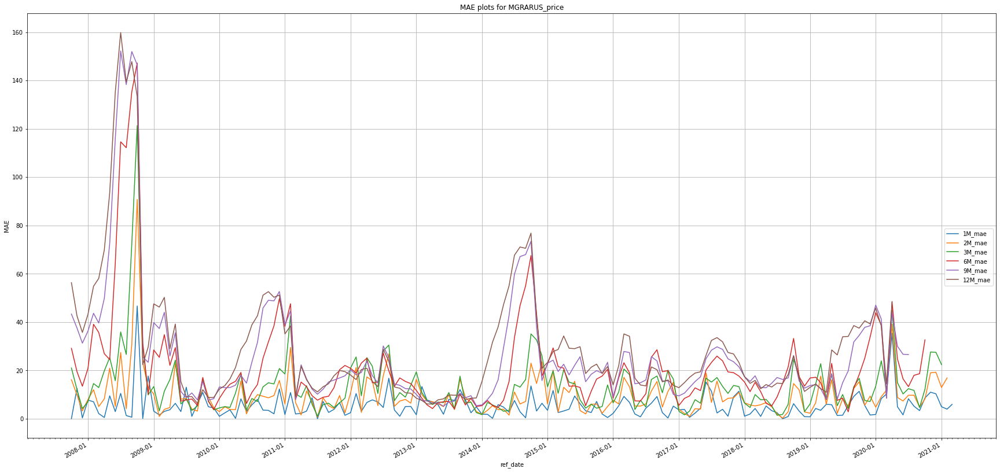

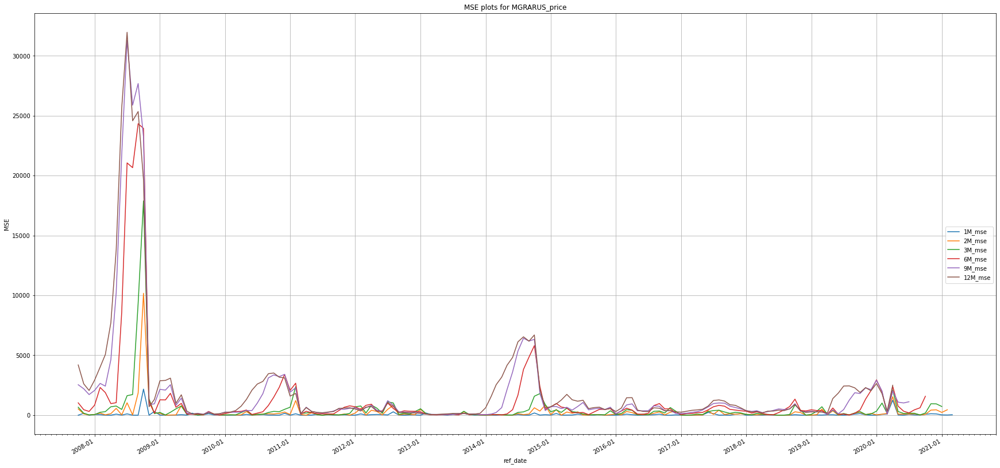

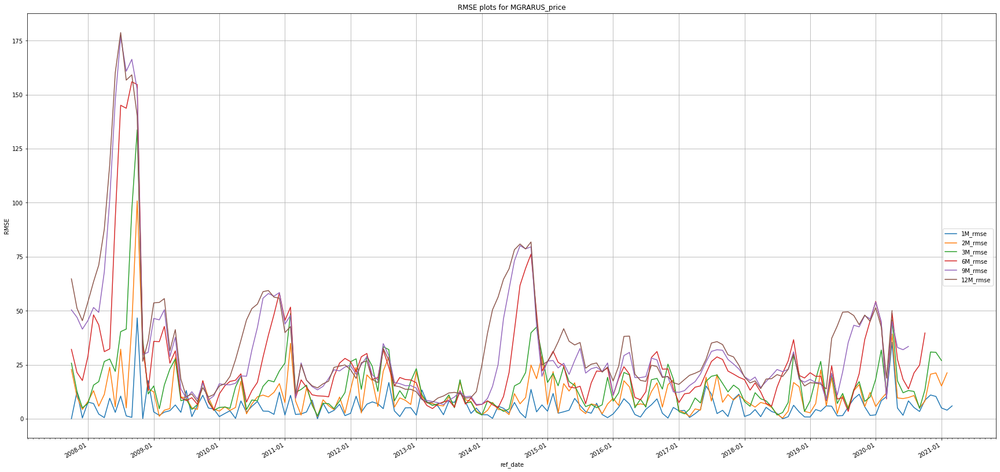

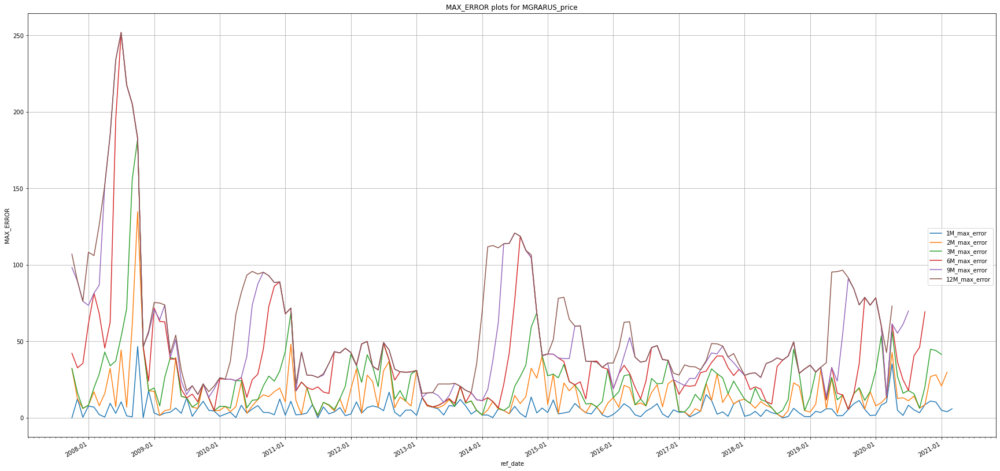




Plotting Evaluations for MGRARUS_pct


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,MGRARUS,2007-10-01,0.000119,1.419611e-08,0.000119,0.000119,0.057727,0.006651,0.081554,0.115335,...,0.048668,0.115335,0.034613,0.002616,0.051144,0.115335,0.031387,0.002118,0.046023,0.115335
1,MGRARUS,2007-11-01,0.044841,2.010673e-03,0.044841,0.044841,0.031214,0.001160,0.034058,0.044841,...,0.026747,0.044841,0.032666,0.001511,0.038876,0.078533,0.040040,0.002653,0.051504,0.128020
2,MGRARUS,2007-12-01,0.001158,1.341235e-06,0.001158,0.001158,0.011230,0.000228,0.015085,0.021301,...,0.024074,0.047783,0.028213,0.001358,0.036847,0.080563,0.056548,0.008603,0.092754,0.269716
3,MGRARUS,2008-01-01,0.025518,6.511593e-04,0.025518,0.025518,0.013760,0.000328,0.018099,0.025518,...,0.046061,0.081031,0.035452,0.001724,0.041523,0.081031,0.076641,0.012173,0.110330,0.273889
4,MGRARUS,2008-02-01,0.023148,5.358211e-04,0.023148,0.023148,0.027523,0.000777,0.027869,0.031898,...,0.046364,0.087190,0.046788,0.003613,0.060106,0.134373,0.080031,0.012655,0.112496,0.275582
5,MGRARUS,2008-03-01,0.007100,5.040883e-05,0.007100,0.007100,0.019205,0.000515,0.022702,0.031311,...,0.046794,0.077852,0.076752,0.012598,0.112239,0.280083,0.085078,0.013319,0.115410,0.280083
6,MGRARUS,2008-04-01,0.001611,2.595238e-06,0.001611,0.001611,0.024645,0.001138,0.033734,0.047680,...,0.040680,0.071808,0.091304,0.016839,0.129767,0.280441,0.081582,0.013585,0.116554,0.280441
7,MGRARUS,2008-05-01,0.027457,7.538979e-04,0.027457,0.027457,0.043900,0.002198,0.046878,0.060343,...,0.079799,0.171272,0.098377,0.017610,0.132701,0.281408,0.082750,0.013845,0.117666,0.281408
8,MGRARUS,2008-06-01,0.007841,6.148442e-05,0.007841,0.007841,0.009093,0.000084,0.009179,0.010344,...,0.144089,0.300752,0.102421,0.019481,0.139574,0.300752,0.089304,0.015615,0.124960,0.300752
9,MGRARUS,2008-07-01,0.025896,6.706084e-04,0.025896,0.025896,0.054415,0.003774,0.061436,0.082934,...,0.168807,0.300503,0.108444,0.020286,0.142429,0.300503,0.108090,0.018622,0.136461,0.300503


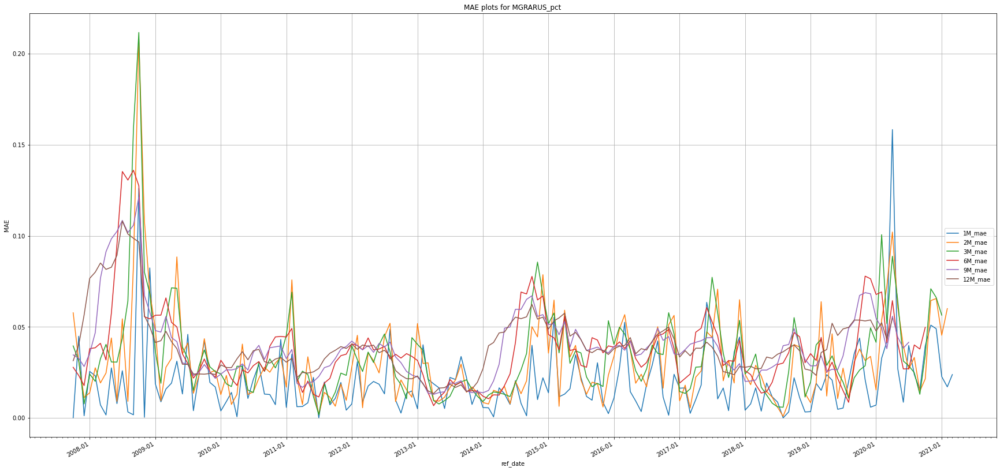

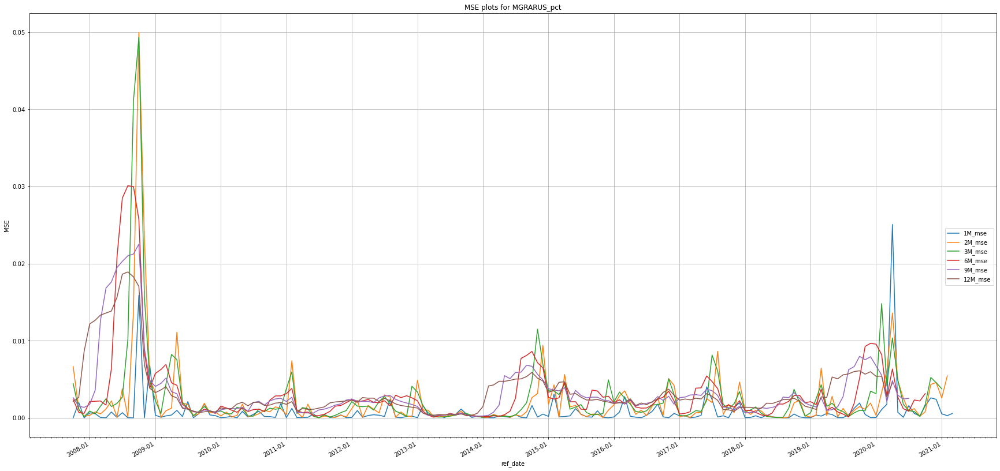

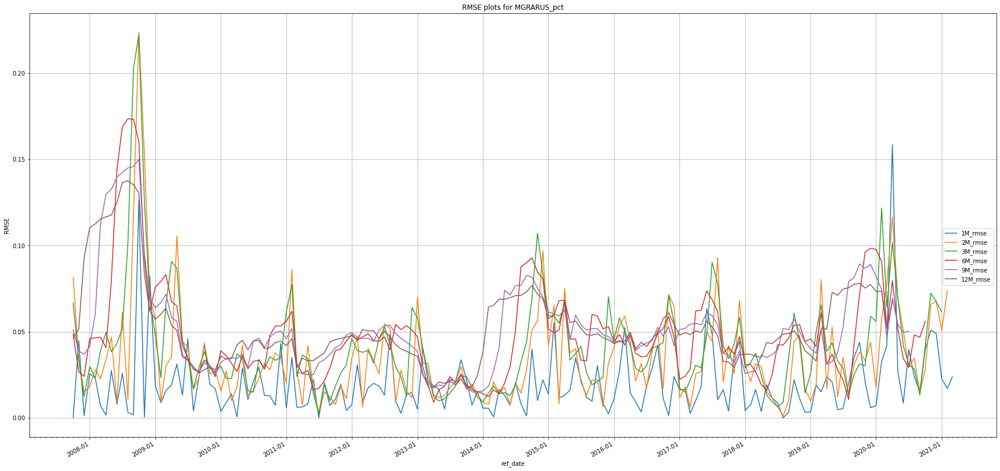

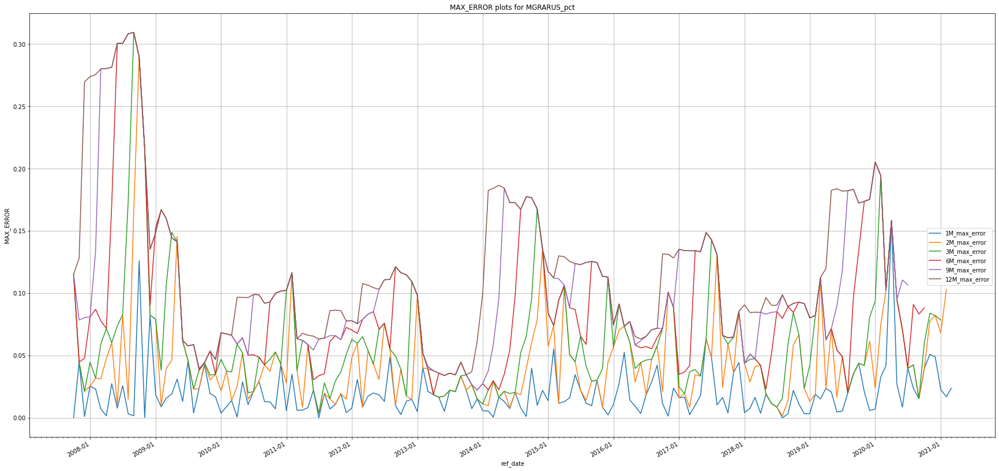




Plotting Evaluations for MGEIAUS_price


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,MGEIAUS,2005-01-01,5.273514,27.809948,5.273514,5.273514,6.578957,44.986851,6.707224,7.884399,...,19.806781,32.302200,34.510501,2070.600452,45.503851,105.358627,40.676935,2529.841818,50.297533,105.358627
1,MGEIAUS,2005-02-01,4.482117,20.089370,4.482117,4.482117,6.145004,40.526273,6.366025,7.807892,...,16.873033,31.003204,35.871863,2415.867623,49.151476,98.405106,37.554076,2240.842189,47.337535,98.405136
2,MGEIAUS,2005-03-01,5.656784,31.999206,5.656784,5.656784,9.455986,103.849607,10.190663,13.255188,...,19.578298,41.794388,29.472159,1716.664302,41.432648,86.707321,30.304468,1567.960452,39.597480,86.707291
3,MGEIAUS,2005-04-01,2.014206,4.057026,2.014206,2.014206,10.114769,167.927426,12.958681,18.215317,...,32.472230,70.908630,23.196903,1071.413196,32.732449,70.908630,21.907673,888.202065,29.802719,70.908600
4,MGEIAUS,2005-05-01,0.279007,0.077845,0.279007,0.279007,0.099449,0.010308,0.101528,0.119888,...,46.308385,80.482285,28.513182,1494.791253,38.662530,80.482315,29.927415,1467.323126,38.305654,80.482285
5,MGEIAUS,2005-06-01,0.513412,0.263592,0.513412,0.513412,7.748207,112.376966,10.600800,14.983002,...,42.833123,76.861725,27.370880,1316.391612,36.282111,76.861694,31.997649,1576.974643,39.711140,76.886688
6,MGEIAUS,2005-07-01,2.043106,4.174282,2.043106,2.043106,9.478798,161.175681,12.695498,17.924393,...,29.680815,56.230515,17.930923,654.869930,25.590427,56.230484,26.654296,1197.367399,34.602997,57.979294
7,MGEIAUS,2005-08-01,13.240112,175.300574,13.240112,13.240112,31.158127,1291.884112,35.942789,49.076141,...,26.320223,49.076141,21.316818,710.369114,26.652751,49.076111,30.099799,1341.395040,36.625060,64.659241
8,MGEIAUS,2005-09-01,4.647583,21.600028,4.647583,4.647583,5.824707,35.312761,5.942454,7.001801,...,17.692392,30.196091,17.328311,505.109421,22.474640,42.451797,26.241262,1089.779029,33.011801,58.592087
9,MGEIAUS,2005-10-01,5.636993,31.775695,5.636993,5.636993,25.345749,840.314131,28.988172,39.413696,...,23.837037,40.213699,23.557290,742.782482,27.254036,40.188705,26.986341,1020.184992,31.940335,52.943726


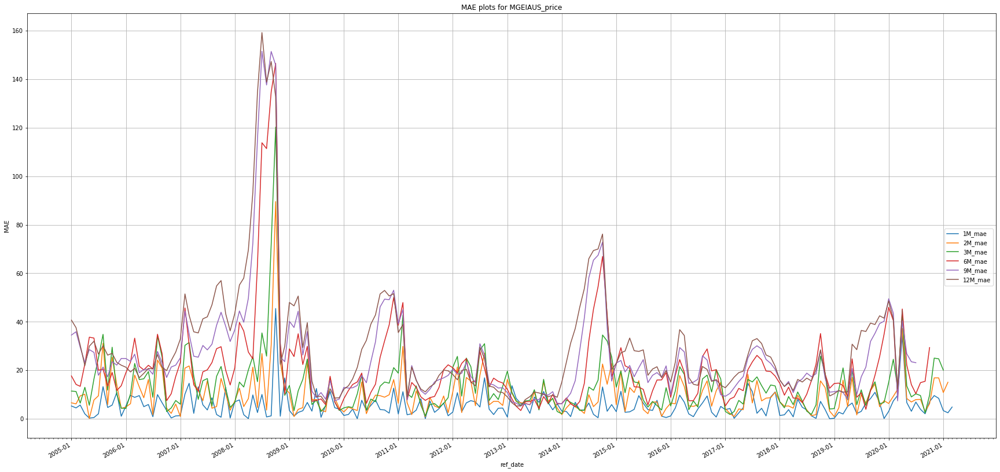

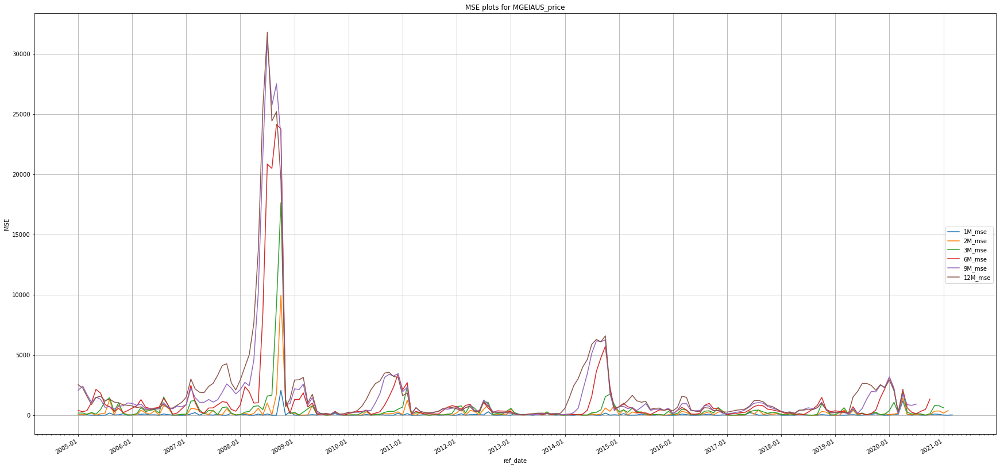

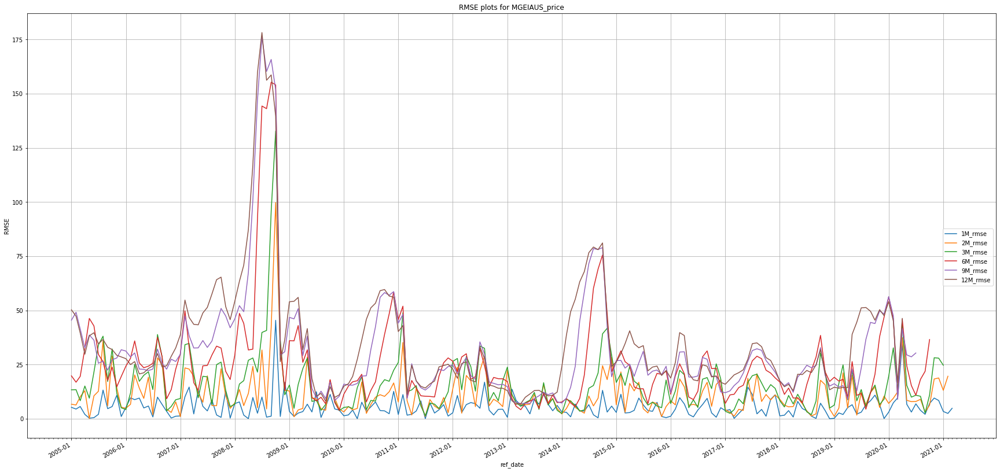

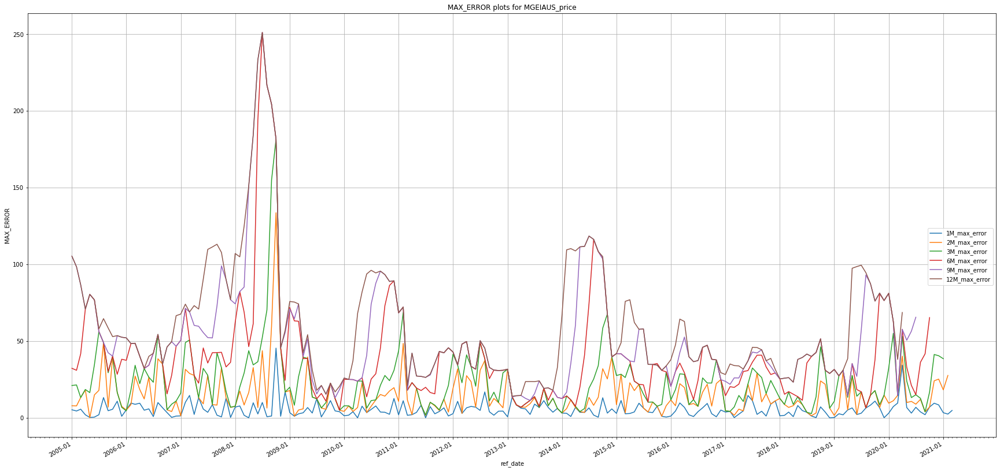




Plotting Evaluations for MGEIAUS_pct


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,MGEIAUS,2005-01-01,0.027947,0.000781,0.027947,0.027947,0.020543,4.768248e-04,0.021836,0.027947,...,0.043997,0.066995,0.065078,0.006730,0.082037,0.178535,0.066172,0.006953,0.083382,0.178535
1,MGEIAUS,2005-02-01,0.023905,0.000571,0.023905,0.023905,0.043692,2.300551e-03,0.047964,0.063480,...,0.058247,0.093288,0.068954,0.007114,0.084347,0.180767,0.072021,0.007569,0.087002,0.180767
2,MGEIAUS,2005-03-01,0.028979,0.000840,0.028979,0.028979,0.031841,1.022065e-03,0.031970,0.034703,...,0.060877,0.100893,0.075782,0.008554,0.092486,0.179715,0.067393,0.007070,0.084085,0.179715
3,MGEIAUS,2005-04-01,0.009501,0.000090,0.009501,0.009501,0.040058,2.538394e-03,0.050382,0.070615,...,0.097369,0.183895,0.075824,0.009546,0.097703,0.183895,0.068016,0.007744,0.088001,0.183895
4,MGEIAUS,2005-05-01,0.001222,0.000001,0.001222,0.001222,0.000624,4.668146e-07,0.000683,0.000902,...,0.086847,0.176504,0.071542,0.008782,0.093713,0.176504,0.067458,0.007630,0.087349,0.176504
5,MGEIAUS,2005-06-01,0.003233,0.000010,0.003233,0.003233,0.034546,2.173941e-03,0.046626,0.065859,...,0.107143,0.166921,0.074226,0.008456,0.091958,0.166921,0.070495,0.007449,0.086307,0.167112
6,MGEIAUS,2005-07-01,0.009300,0.000086,0.009300,0.009300,0.038285,2.626128e-03,0.051246,0.072350,...,0.092232,0.150293,0.061432,0.006392,0.079949,0.150293,0.059324,0.005908,0.076864,0.150484
7,MGEIAUS,2005-08-01,0.061179,0.003743,0.061179,0.061179,0.100745,1.171492e-02,0.108235,0.140310,...,0.094247,0.143681,0.070081,0.007155,0.084589,0.143681,0.060099,0.005598,0.074823,0.143651
8,MGEIAUS,2005-09-01,0.018377,0.000338,0.018377,0.018377,0.028280,8.978396e-04,0.029964,0.038183,...,0.060620,0.113869,0.049800,0.004128,0.064247,0.113838,0.043147,0.003325,0.057661,0.113838
9,MGEIAUS,2005-10-01,0.019102,0.000365,0.019102,0.019102,0.071211,6.159523e-03,0.078483,0.104204,...,0.067862,0.110157,0.053035,0.004531,0.067311,0.110455,0.057527,0.005662,0.075245,0.154871


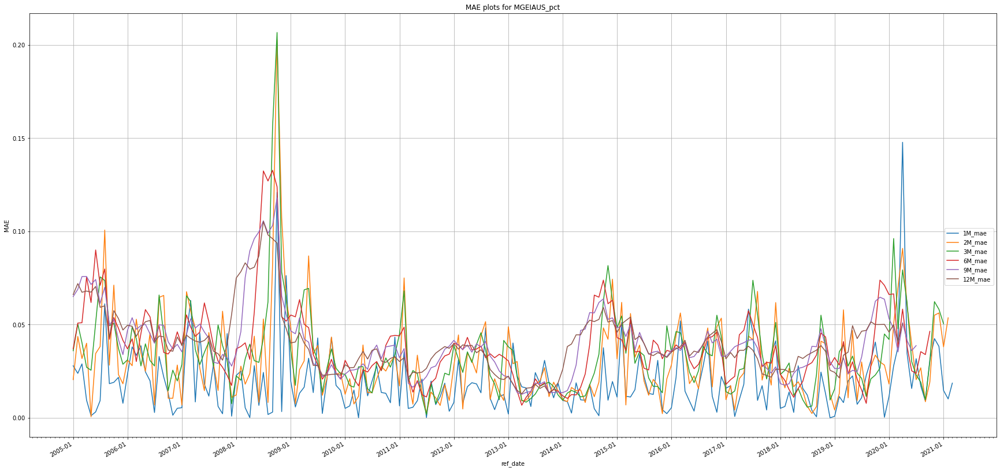

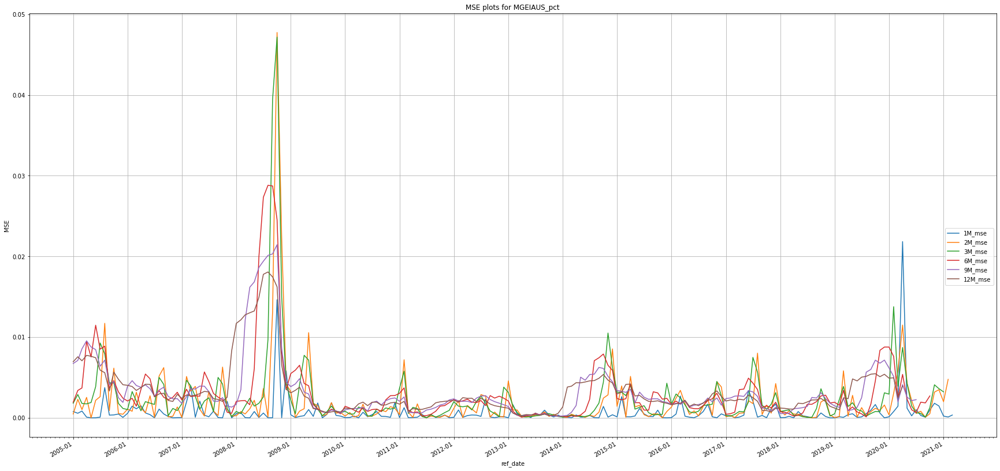

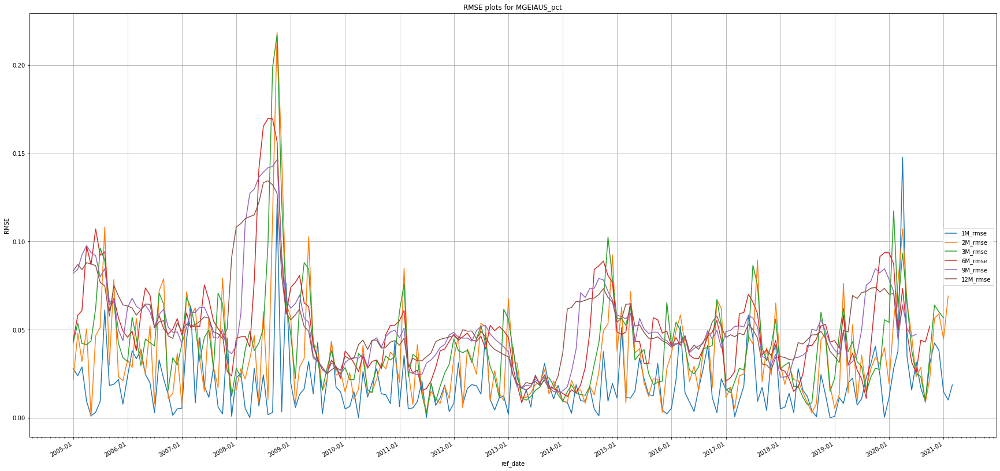

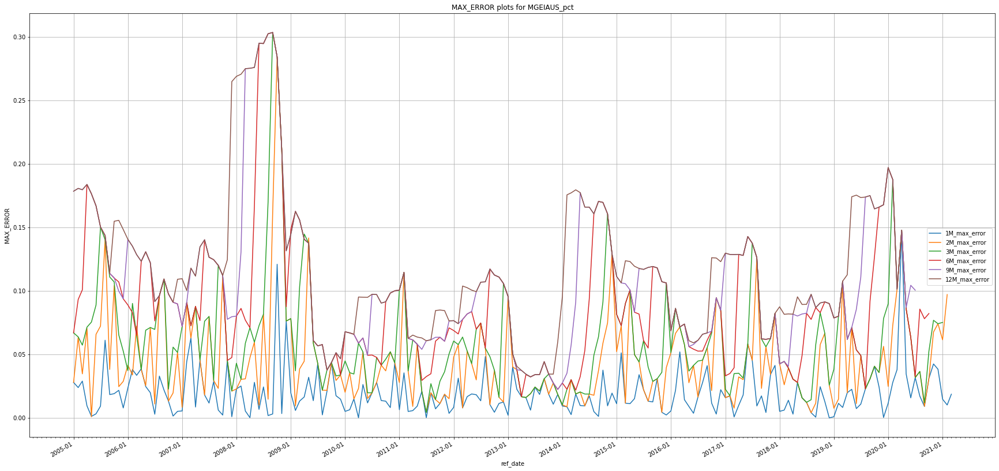




Plotting Evaluations for DSRTUUS_price


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,DSRTUUS,2005-01-01,1.733673,3.005622,1.733673,1.733673,5.063454,36.725900,6.060190,8.393219,...,31.153124,45.329575,42.440740,2530.818788,50.307244,95.662704,52.447094,3797.953631,61.627540,121.798492
1,DSRTUUS,2005-02-01,1.409103,1.985572,1.409103,1.409103,10.984749,212.357693,14.572498,20.560394,...,29.620599,46.827972,46.738520,3285.860165,57.322423,114.288300,48.413548,3185.989841,56.444573,114.288300
2,DSRTUUS,2005-03-01,6.869598,47.191382,6.869598,6.869598,13.322456,219.127023,14.802940,19.775299,...,30.017299,50.619705,43.413171,2774.457694,52.673121,104.235092,42.600737,2484.256875,49.842320,104.235092
3,DSRTUUS,2005-04-01,0.423996,0.179773,0.423996,0.423996,3.781868,25.577727,5.057443,7.139725,...,27.513261,57.172516,27.705295,1414.857414,37.614590,83.364700,26.336347,1189.308420,34.486351,83.364700
4,DSRTUUS,2005-05-01,5.418091,29.355708,5.418091,5.418091,15.151146,324.289585,18.008042,24.884201,...,57.131304,97.197906,44.225452,2617.817805,51.164615,97.197906,45.498024,2604.056308,51.029955,97.197906
5,DSRTUUS,2005-06-01,9.363312,87.671607,9.363312,9.363312,14.200798,225.064086,15.002136,19.038300,...,44.257291,79.868698,31.809892,1459.030573,38.197259,79.868698,36.860933,1829.117890,42.768188,79.868668
6,DSRTUUS,2005-07-01,1.686310,2.843641,1.686310,1.686310,6.268250,60.285403,7.764368,10.850220,...,32.513921,65.851700,20.794186,801.394081,28.308905,65.851700,29.512685,1399.232663,37.406318,65.851730
7,DSRTUUS,2005-08-01,13.675293,187.013638,13.675293,13.675293,26.114937,836.735424,28.926379,38.554611,...,33.922746,67.579193,28.771910,1152.772029,33.952497,67.579193,38.455653,2005.332680,44.780941,70.873917
8,DSRTUUS,2005-09-01,8.406982,70.677353,8.406982,8.406982,21.406036,627.193797,25.043838,34.405090,...,19.710345,34.405090,19.581360,543.091340,23.304320,43.616516,27.717021,1096.865197,33.118955,60.546906
9,DSRTUUS,2005-10-01,9.487061,90.004318,9.487061,9.487061,16.975723,344.255250,18.554117,24.464386,...,17.472677,29.011673,20.059769,545.754370,23.361386,37.551270,24.594363,840.887801,28.998065,54.615311


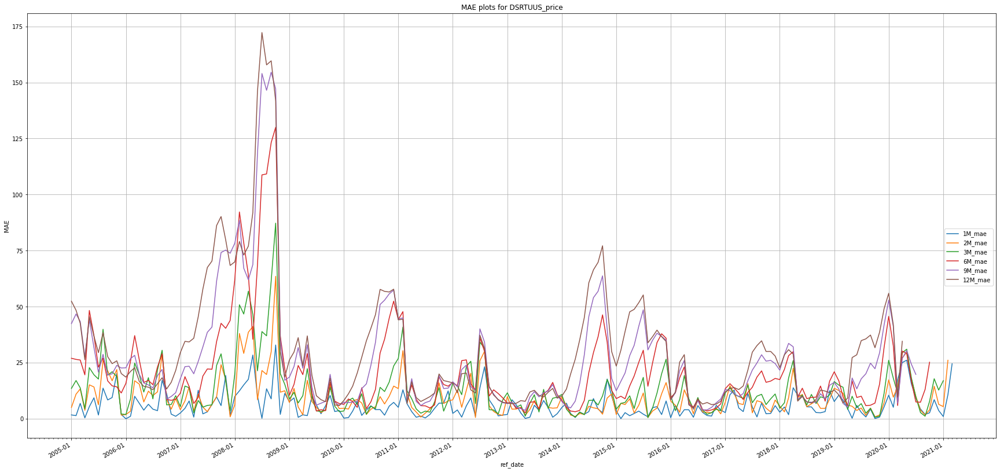

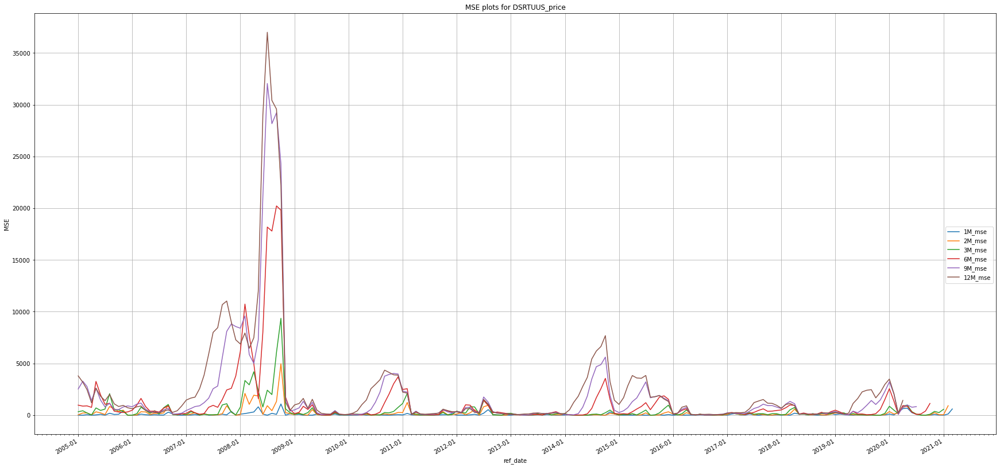

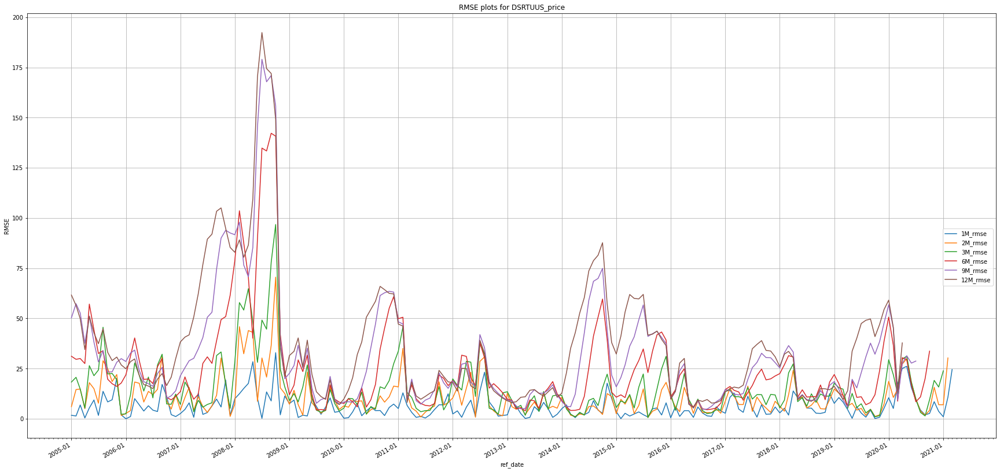

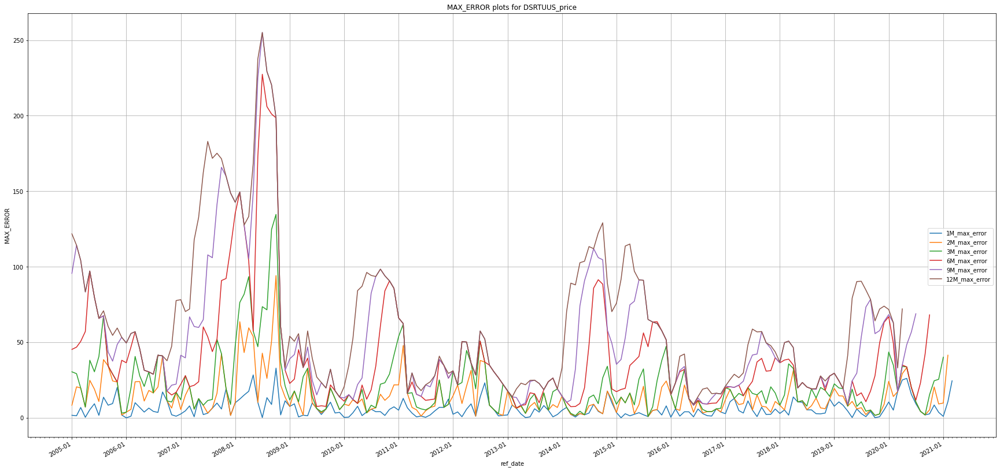




Plotting Evaluations for DSRTUUS_pct


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,DSRTUUS,2005-01-01,0.008630,0.000074,0.008630,0.008630,0.021370,0.000619,0.024880,0.034111,...,0.053996,0.095975,0.053711,0.003670,0.060578,0.102219,0.066028,0.006079,0.077971,0.172140
1,DSRTUUS,2005-02-01,0.007193,0.000052,0.007193,0.007193,0.051435,0.004603,0.067845,0.095677,...,0.050863,0.080931,0.059323,0.004278,0.065410,0.106389,0.062754,0.005863,0.076573,0.172836
2,DSRTUUS,2005-03-01,0.034348,0.001180,0.034348,0.034348,0.046689,0.002332,0.048292,0.059030,...,0.046216,0.059030,0.069668,0.006880,0.082945,0.172575,0.056556,0.005333,0.073029,0.172575
3,DSRTUUS,2005-04-01,0.001915,0.000004,0.001915,0.001915,0.015618,0.000432,0.020778,0.029321,...,0.059160,0.106526,0.067855,0.006826,0.082619,0.172857,0.054274,0.005223,0.072273,0.172857
4,DSRTUUS,2005-05-01,0.023639,0.000559,0.023639,0.023639,0.056682,0.004305,0.065610,0.089725,...,0.068896,0.091123,0.069986,0.006935,0.083279,0.176834,0.062640,0.005750,0.075827,0.176835
5,DSRTUUS,2005-06-01,0.042580,0.001813,0.042580,0.042580,0.042542,0.001810,0.042542,0.042580,...,0.093553,0.173268,0.061702,0.006061,0.077854,0.173268,0.061487,0.005537,0.074411,0.173268
6,DSRTUUS,2005-07-01,0.007367,0.000054,0.007367,0.007367,0.030101,0.001423,0.037721,0.052835,...,0.094166,0.164420,0.060720,0.006198,0.078726,0.164420,0.058620,0.005545,0.074464,0.164420
7,DSRTUUS,2005-08-01,0.057629,0.003321,0.057629,0.057629,0.077760,0.006452,0.080324,0.097892,...,0.093582,0.161830,0.067904,0.006524,0.080772,0.161830,0.058439,0.005317,0.072915,0.161830
8,DSRTUUS,2005-09-01,0.033628,0.001131,0.033628,0.033628,0.062839,0.004802,0.069297,0.092050,...,0.082088,0.160157,0.066051,0.005875,0.076650,0.160157,0.054473,0.004534,0.067333,0.160157
9,DSRTUUS,2005-10-01,0.033654,0.001133,0.033654,0.033654,0.070744,0.006380,0.079877,0.107833,...,0.055133,0.107833,0.046262,0.003015,0.054911,0.107833,0.051009,0.003960,0.062925,0.136145


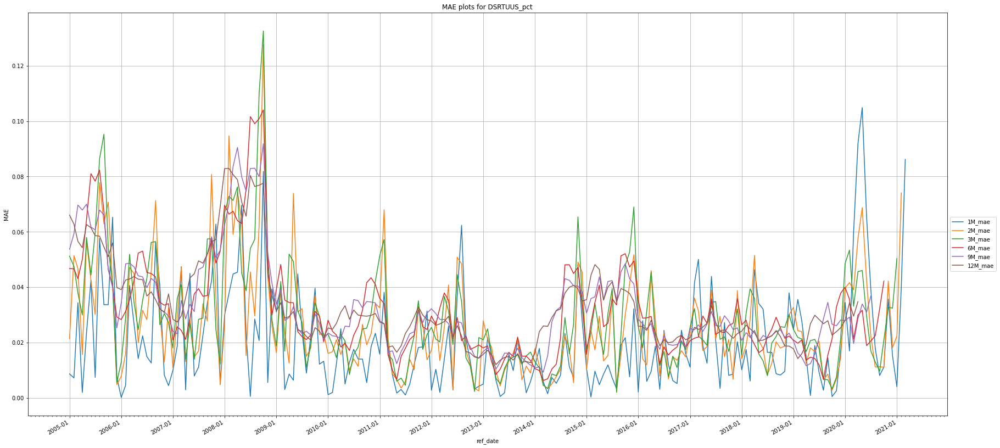

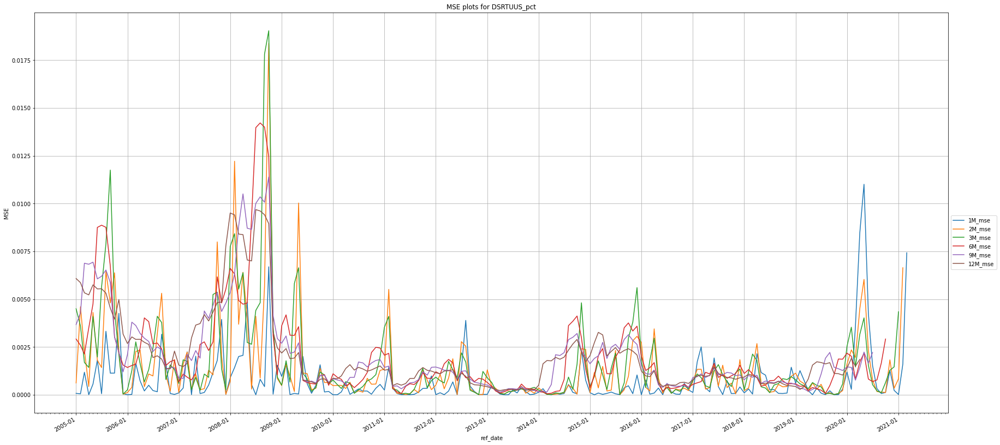

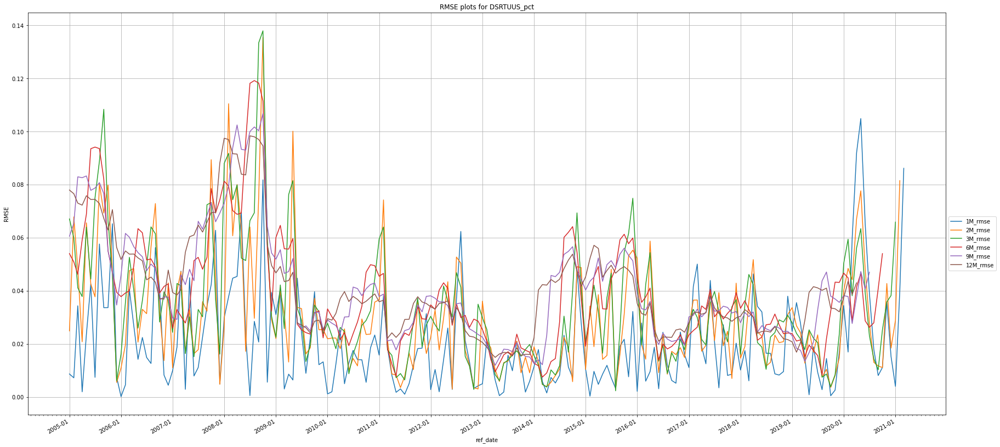

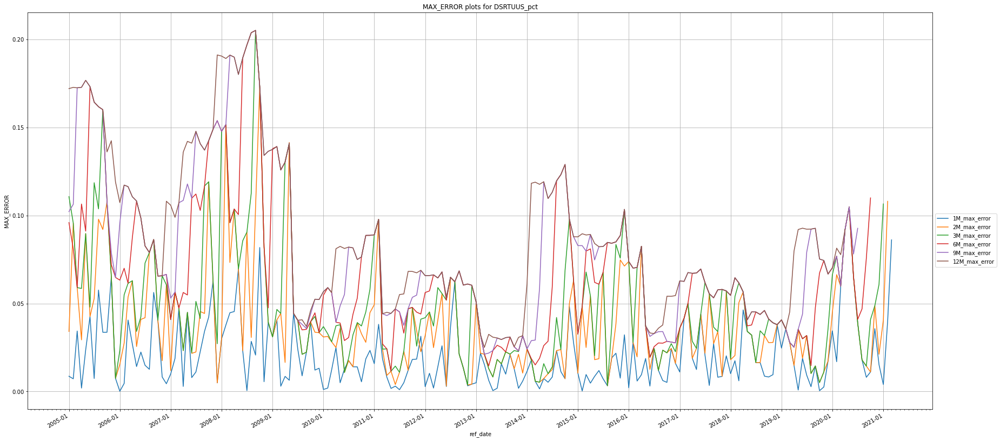




Plotting Evaluations for D2RCAUS_price


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,D2RCAUS,2007-10-01,7.0508,49.713781,7.0508,7.0508,20.45505,660.066977,25.691769,36.0004,...,48.430915,87.666800,69.759282,7300.885180,85.445217,160.669000,89.891216,11292.017750,106.263906,182.695775
1,D2RCAUS,2007-11-01,19.3880,375.894544,19.3880,19.3880,24.96880,634.016477,25.179684,28.2208,...,47.972391,85.890900,70.652569,7731.375066,87.928238,156.364000,78.234616,8818.753789,93.908220,170.307524
2,D2RCAUS,2007-12-01,4.1048,16.849383,4.1048,4.1048,6.04695,60.729219,7.792895,10.9626,...,51.664925,97.386300,68.355450,7401.401641,86.031399,143.361500,64.772676,6800.711975,82.466429,156.637324
3,D2RCAUS,2008-01-01,3.3865,11.468382,3.3865,3.3865,4.51370,21.875093,4.677082,5.7391,...,72.089326,129.122200,77.086050,8544.460467,92.436251,153.231575,66.763806,6678.850302,81.724233,153.269524
4,D2RCAUS,2008-02-01,6.4288,41.329469,6.4288,6.4288,27.92850,1262.686406,35.534299,49.8986,...,93.412950,143.299400,80.755862,8889.490408,94.284094,157.242924,71.051621,7217.009489,84.952984,157.242924
5,D2RCAUS,2008-03-01,12.3276,151.969722,12.3276,12.3276,25.91320,925.870915,30.428127,41.8624,...,84.926607,124.589800,64.730702,6158.635490,78.476974,137.865624,65.523183,5755.693984,75.866290,137.865624
6,D2RCAUS,2008-04-01,19.8896,395.596188,19.8896,19.8896,32.82585,1413.765494,37.600073,51.1624,...,74.252278,113.433275,62.745467,5189.117198,72.035527,113.471224,69.248432,5995.885216,77.433102,115.574400
7,D2RCAUS,2008-05-01,23.1745,537.057450,23.1745,23.1745,41.12130,1814.664647,42.598881,52.2435,...,46.121139,72.563324,66.202739,6356.147317,79.725450,134.728200,83.081795,9311.870229,96.498032,149.150100
8,D2RCAUS,2008-06-01,1.3449,1.808756,1.3449,1.3449,1.11635,1.984204,1.408618,1.9754,...,92.714010,177.427600,107.372372,17498.968098,132.283665,209.335600,130.746204,23218.789410,152.377129,207.597072
9,D2RCAUS,2008-07-01,8.9205,79.575320,8.9205,8.9205,29.79990,1352.311558,36.773789,51.3470,...,136.559494,229.066900,145.403504,27698.592366,166.428941,236.516900,158.610787,30573.435393,174.852610,224.137287


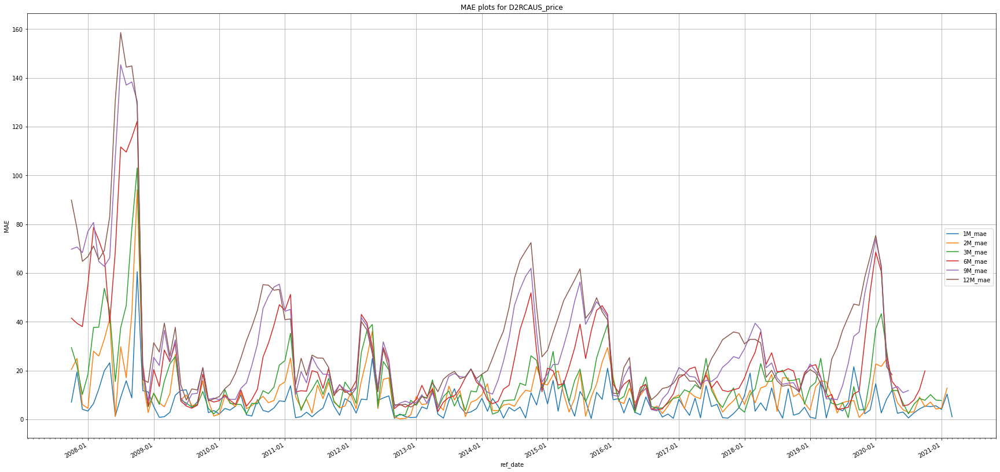

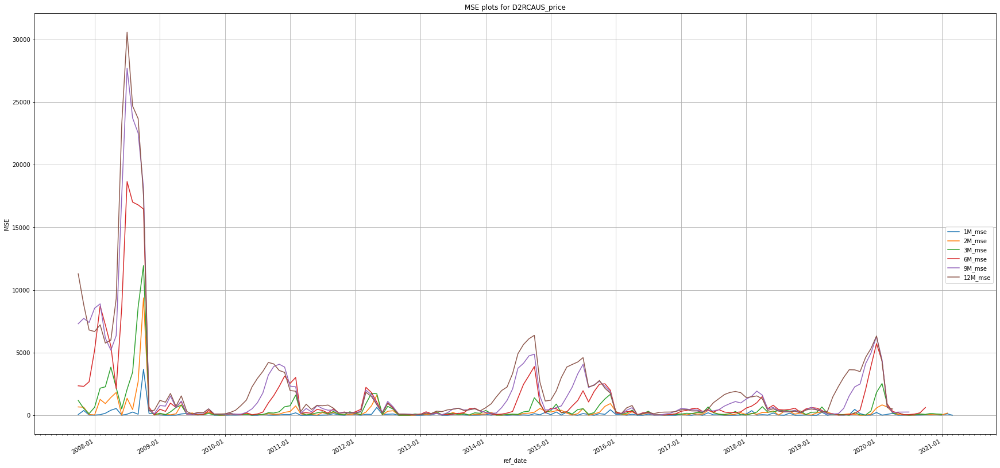

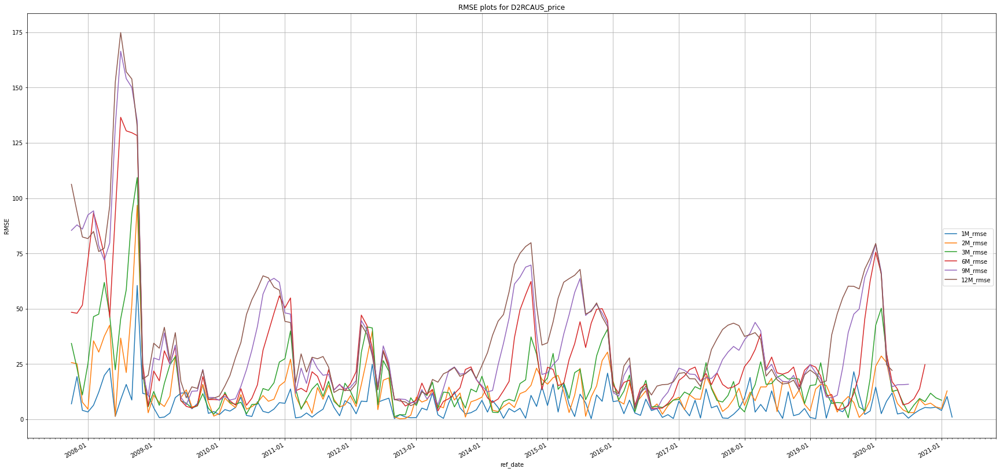

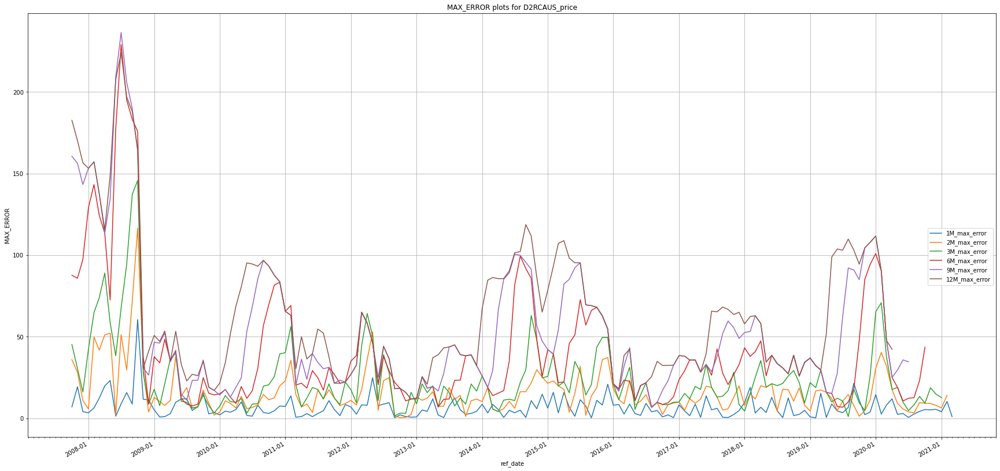




Plotting Evaluations for D2RCAUS_pct


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,D2RCAUS,2007-10-01,0.034339,0.001179,0.034339,0.034339,0.072446,0.006462,0.080387,0.107284,...,0.061125,0.111604,0.054793,0.004129,0.064256,0.101738,0.056882,0.004105,0.064073,0.101490
1,D2RCAUS,2007-11-01,0.074871,0.005606,0.074871,0.074871,0.051782,0.003712,0.060930,0.083893,...,0.058547,0.120460,0.051284,0.003563,0.059689,0.099720,0.065469,0.005800,0.076158,0.151132
2,D2RCAUS,2007-12-01,0.005301,0.000028,0.005301,0.005301,0.027705,0.000847,0.029110,0.036639,...,0.061603,0.105996,0.055410,0.004275,0.065384,0.106538,0.078744,0.008868,0.094168,0.183243
3,D2RCAUS,2008-01-01,0.005858,0.000034,0.005858,0.005858,0.019896,0.000443,0.021058,0.026796,...,0.077572,0.119054,0.065355,0.005408,0.073540,0.106685,0.088391,0.010117,0.100581,0.169275
4,D2RCAUS,2008-02-01,0.026187,0.000686,0.026187,0.026187,0.084438,0.009223,0.096037,0.130192,...,0.079380,0.120078,0.084969,0.008623,0.092858,0.152464,0.088271,0.009732,0.098649,0.150304
5,D2RCAUS,2008-03-01,0.037866,0.001434,0.037866,0.037866,0.067878,0.004983,0.070592,0.087264,...,0.079064,0.104099,0.098904,0.011940,0.109271,0.183215,0.084914,0.008512,0.092261,0.143014
6,D2RCAUS,2008-04-01,0.059840,0.003581,0.059840,0.059840,0.080983,0.006819,0.082578,0.097135,...,0.078511,0.105497,0.103153,0.012222,0.110552,0.170649,0.082554,0.008175,0.090414,0.138890
7,D2RCAUS,2008-05-01,0.075242,0.005661,0.075242,0.075242,0.074031,0.005896,0.076786,0.094412,...,0.091288,0.150330,0.086013,0.009229,0.096067,0.140289,0.070714,0.006751,0.082165,0.140289
8,D2RCAUS,2008-06-01,0.014160,0.000201,0.014160,0.014160,0.002308,0.000008,0.002823,0.003934,...,0.110567,0.176916,0.074989,0.007703,0.087765,0.136715,0.057253,0.005683,0.075388,0.136715
9,D2RCAUS,2008-07-01,0.017883,0.000320,0.017883,0.017883,0.063067,0.005187,0.072021,0.097846,...,0.121432,0.172372,0.078178,0.008399,0.091646,0.141733,0.064016,0.006582,0.081128,0.141672


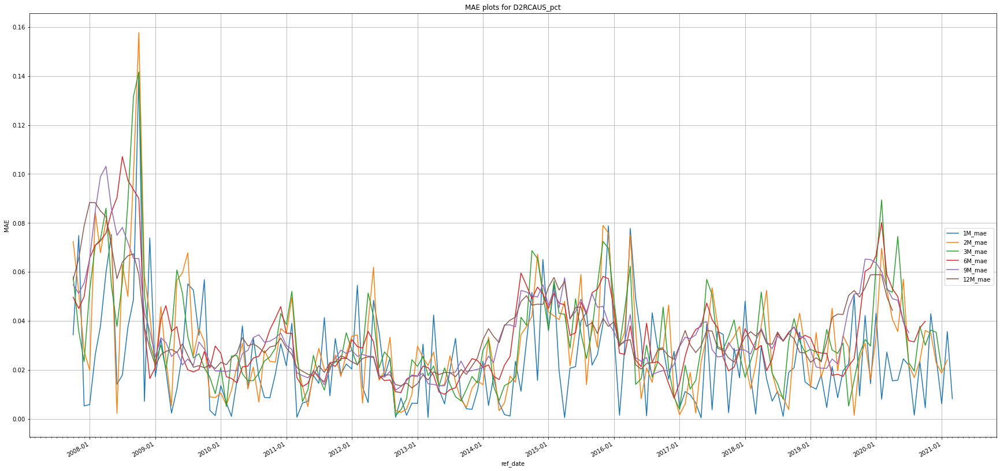

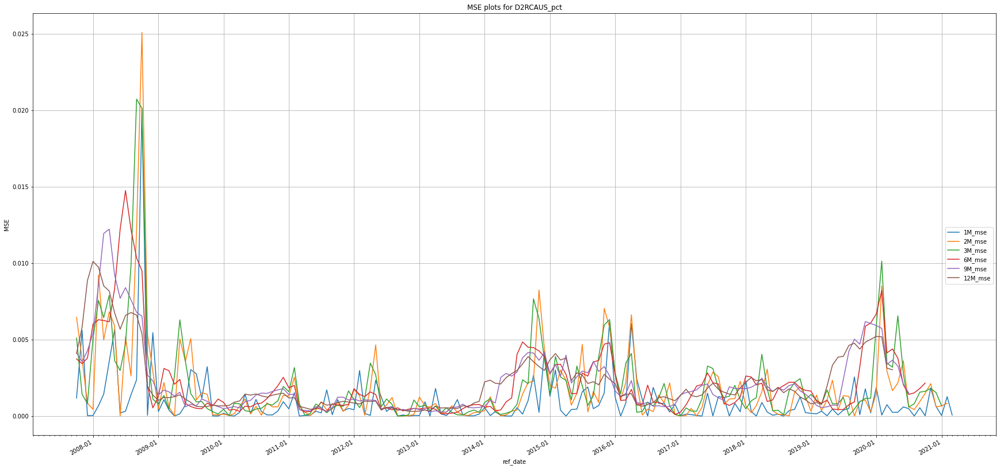

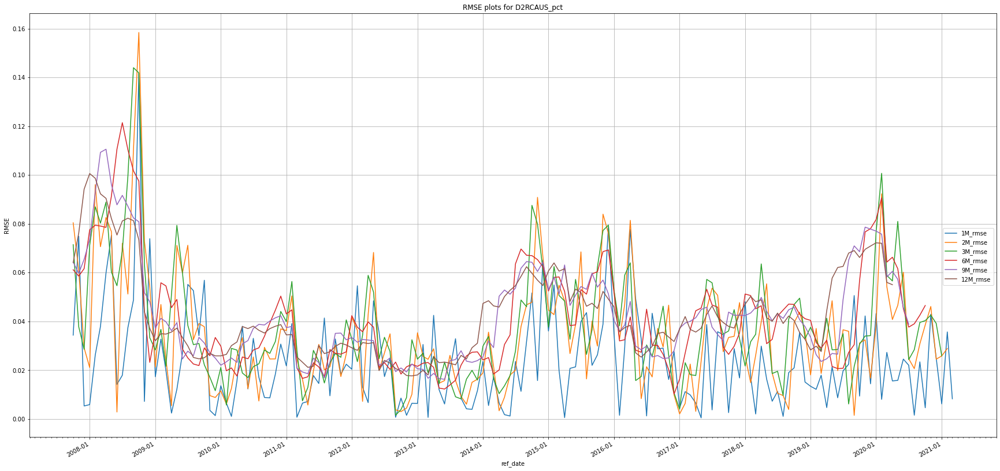

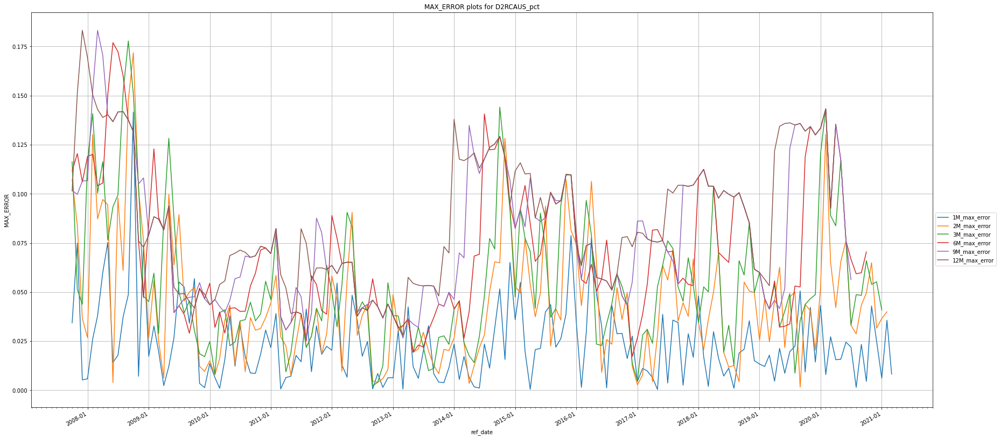




Plotting Evaluations for NGHHMCF_price


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,NGHHMCF,2007-10-01,0.397238,0.157798,0.397238,0.397238,0.244177,0.083050,0.288184,0.397238,...,0.893116,1.961446,1.919944,7.529749,2.744039,5.817087,1.898137,7.161043,2.676012,5.810907
1,NGHHMCF,2007-11-01,0.588602,0.346452,0.588602,0.588602,0.781192,0.647351,0.804581,0.973781,...,1.408568,2.846163,2.262560,8.558440,2.925481,5.584074,1.872460,6.585450,2.566213,5.584074
2,NGHHMCF,2007-12-01,0.439616,0.193262,0.439616,0.439616,0.229989,0.096838,0.311189,0.439616,...,2.284462,4.247905,2.380349,9.333045,3.055003,5.783921,2.005505,7.251158,2.692797,5.783921
3,NGHHMCF,2008-01-01,0.151208,0.022864,0.151208,0.151208,0.439427,0.276167,0.525516,0.727647,...,3.194905,5.658907,2.331165,8.824364,2.970583,5.652727,2.147390,7.387621,2.718018,5.652727
4,NGHHMCF,2008-02-01,0.512521,0.262678,0.512521,0.512521,1.099196,1.552421,1.245962,1.685872,...,3.490399,5.548860,2.311925,8.365401,2.892300,5.548860,2.291713,7.673808,2.770164,5.548860
5,NGHHMCF,2008-03-01,0.593833,0.352638,0.593833,0.593833,1.313362,2.241860,1.497284,2.032348,...,3.137970,5.188755,2.070817,6.897395,2.626289,5.188755,2.352418,7.827488,2.797765,5.188755
6,NGHHMCF,2008-04-01,1.209919,1.463904,1.209919,1.209919,2.022182,4.747472,2.178869,2.833509,...,2.679924,4.690525,2.071445,6.161688,2.482275,4.690525,2.569078,8.782212,2.963480,4.690525
7,NGHHMCF,2008-05-01,1.457580,2.124539,1.457580,1.457580,2.310826,6.067946,2.463320,3.164072,...,2.171337,3.157892,2.715050,8.975392,2.995896,4.883050,3.460752,14.849498,3.853505,5.792141
8,NGHHMCF,2008-06-01,1.271970,1.617908,1.271970,1.271970,0.779194,0.843919,0.918650,1.265790,...,3.657638,5.330440,4.582076,27.482371,5.242363,8.391660,5.353633,35.395766,5.949434,8.391660
9,NGHHMCF,2008-07-01,1.834887,3.366811,1.834887,1.834887,3.335009,13.372646,3.656863,4.835130,...,5.720314,7.494240,6.523676,47.206789,6.870720,9.047830,6.793141,49.955522,7.067922,9.047830


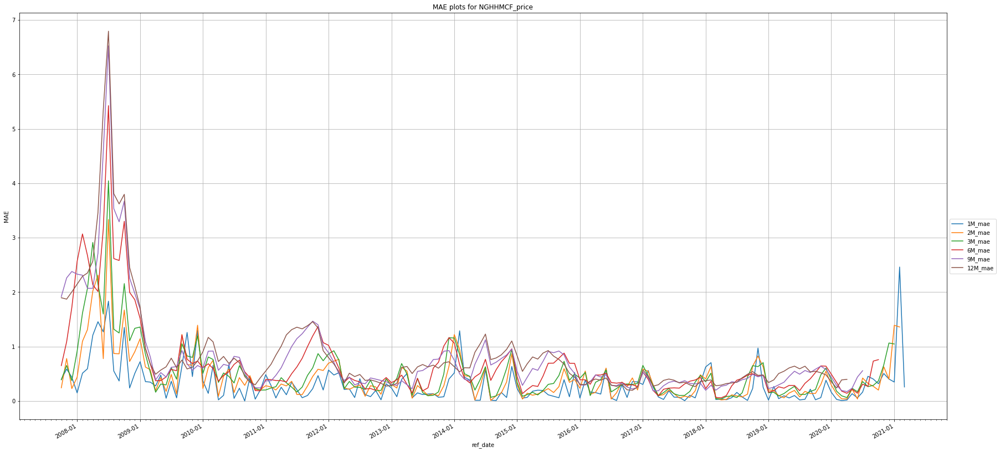

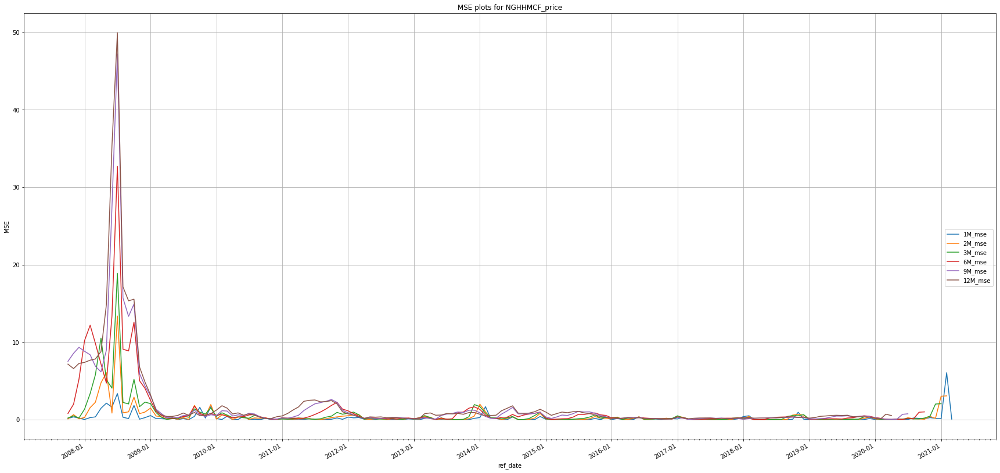

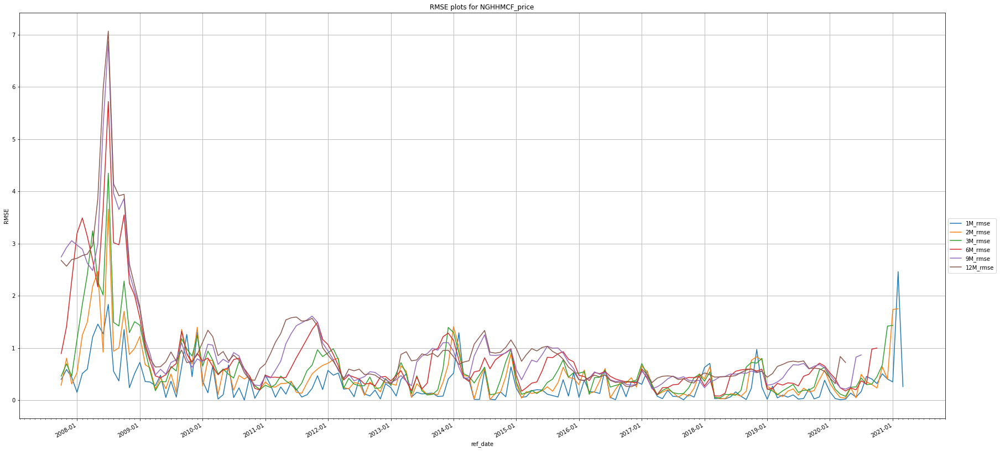

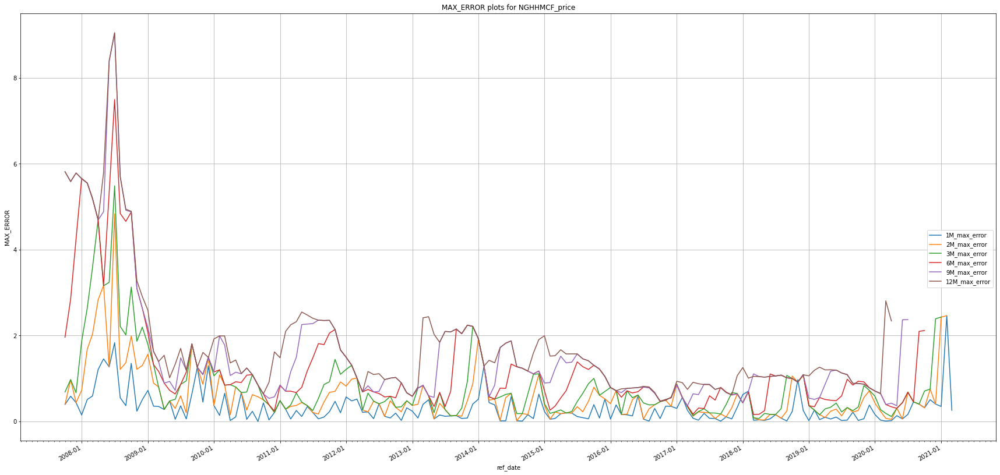




Plotting Evaluations for NGHHMCF_pct


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,NGHHMCF,2007-10-01,0.063432,0.004024,0.063432,0.063432,0.070645,0.005043,0.071012,0.077857,...,0.101035,0.184318,0.102468,0.012147,0.110213,0.184380,0.118196,0.017465,0.132156,0.272790
1,NGHHMCF,2007-11-01,0.084786,0.007189,0.084786,0.084786,0.066725,0.004778,0.069126,0.084786,...,0.105071,0.149809,0.104785,0.012068,0.109856,0.149809,0.123786,0.018971,0.137736,0.294725
2,NGHHMCF,2007-12-01,0.060114,0.003614,0.060114,0.060114,0.063266,0.004012,0.063344,0.066417,...,0.104073,0.150839,0.125447,0.019859,0.140922,0.286423,0.120606,0.017994,0.134143,0.284837
3,NGHHMCF,2008-01-01,0.020653,0.000427,0.020653,0.020653,0.045347,0.002666,0.051635,0.070041,...,0.106917,0.137394,0.118271,0.017460,0.132135,0.254140,0.121117,0.018043,0.134325,0.254140
4,NGHHMCF,2008-02-01,0.062160,0.003864,0.062160,0.062160,0.098704,0.011078,0.105252,0.135248,...,0.117121,0.141439,0.131296,0.019714,0.140408,0.248783,0.126062,0.018385,0.135591,0.248783
5,NGHHMCF,2008-03-01,0.067752,0.004590,0.067752,0.067752,0.110015,0.013884,0.117831,0.152216,...,0.154100,0.241987,0.127644,0.019550,0.139823,0.240402,0.130258,0.019471,0.139540,0.240402
6,NGHHMCF,2008-04-01,0.124113,0.015404,0.124113,0.124113,0.142304,0.020578,0.143450,0.160398,...,0.157049,0.249111,0.135001,0.021746,0.147466,0.249111,0.128950,0.019482,0.139578,0.249111
7,NGHHMCF,2008-05-01,0.138911,0.019296,0.138911,0.138911,0.144448,0.020896,0.144554,0.149984,...,0.154569,0.240904,0.126498,0.019742,0.140506,0.240904,0.118787,0.017296,0.131514,0.240904
8,NGHHMCF,2008-06-01,0.109140,0.011912,0.109140,0.109140,0.113701,0.012954,0.113815,0.118792,...,0.138421,0.255855,0.128854,0.019807,0.140737,0.255855,0.118246,0.017225,0.131242,0.255855
9,NGHHMCF,2008-07-01,0.139967,0.019591,0.139967,0.139967,0.200793,0.044018,0.209804,0.261619,...,0.144030,0.260033,0.118709,0.018075,0.134442,0.260033,0.108184,0.015509,0.124536,0.260033


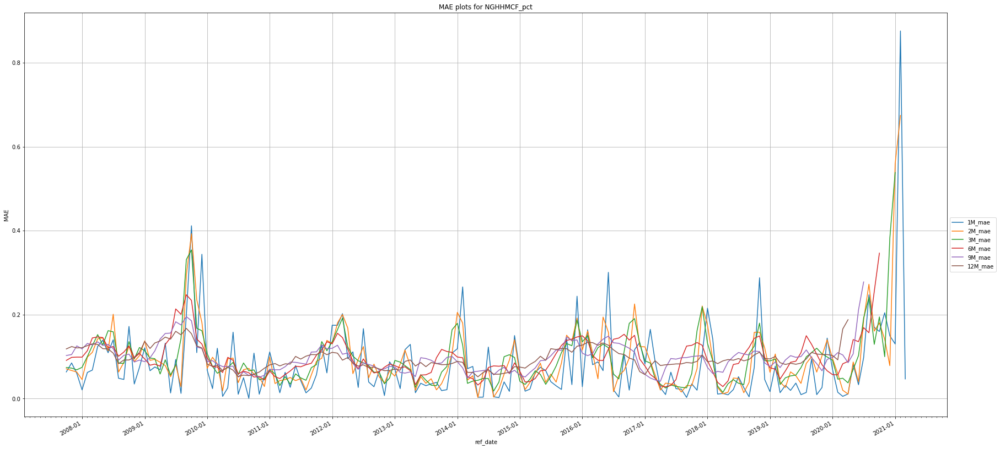

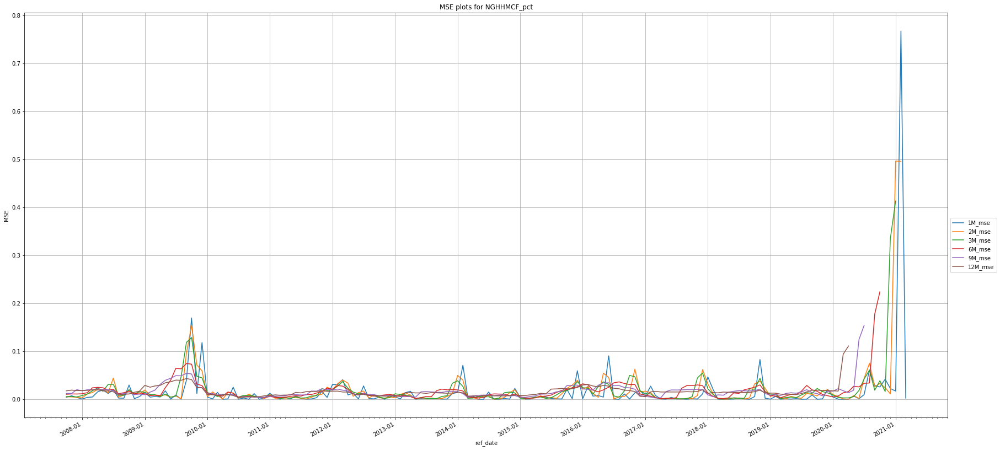

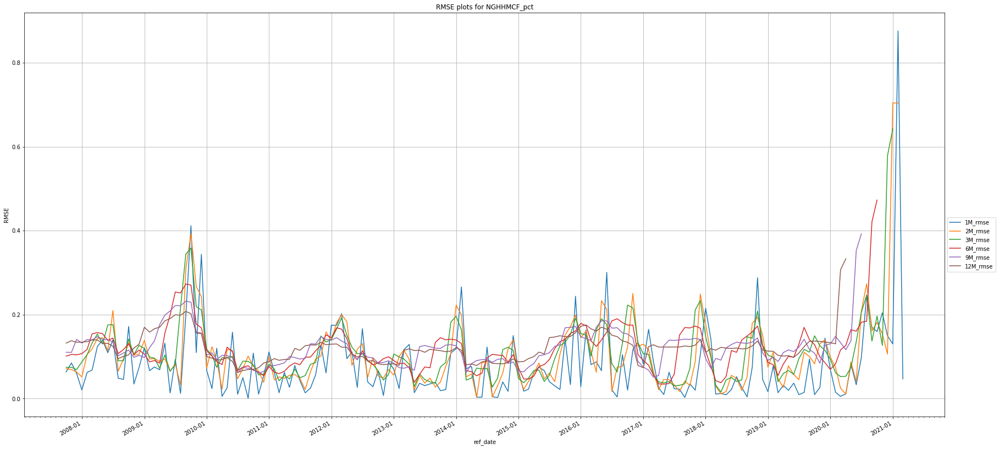

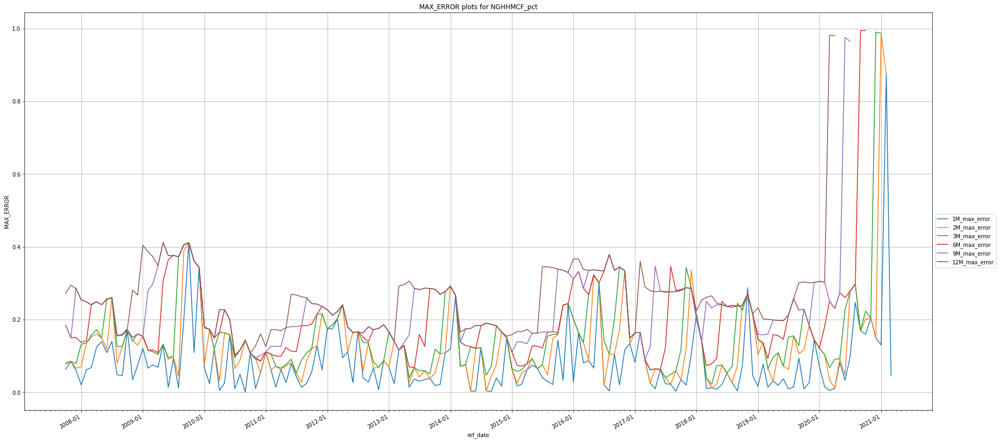




Plotting Evaluations for NGRCUUS_price


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,NGRCUUS,2005-01-01,0.268090,0.071872,0.268090,0.268090,0.170370,0.029782,0.172574,0.197861,...,1.253610,2.015360,1.455579,2.805935,1.675092,2.752450,2.355259,8.177371,2.859610,5.280849
1,NGRCUUS,2005-02-01,0.164201,0.026962,0.164201,0.164201,0.400711,0.165129,0.406361,0.468241,...,1.703648,2.471630,2.408124,7.270626,2.696410,4.646800,3.023341,11.442422,3.382665,5.620230
2,NGRCUUS,2005-03-01,0.375300,0.140850,0.375300,0.375300,1.059535,1.122891,1.059666,1.076199,...,2.002936,2.465400,2.888520,10.093769,3.177069,5.290569,3.067840,11.432563,3.381207,5.470570
3,NGRCUUS,2005-04-01,0.438729,0.192483,0.438729,0.438729,0.964415,1.023956,1.011907,1.270781,...,1.231438,1.668530,2.059476,5.425277,2.329222,4.201421,1.975094,5.294070,2.300885,4.201421
4,NGRCUUS,2005-05-01,0.670031,0.448941,0.670031,0.670031,1.220120,1.533438,1.238321,1.431650,...,1.903538,3.207081,2.082804,5.555974,2.357111,4.180511,1.957707,5.343147,2.311525,4.180511
5,NGRCUUS,2005-06-01,0.655639,0.429862,0.655639,0.655639,0.414535,0.334784,0.578605,0.818199,...,2.309216,3.782220,2.142733,6.067991,2.463329,3.962220,2.133443,5.986085,2.446648,4.002221
6,NGRCUUS,2005-07-01,0.493359,0.243403,0.493359,0.493359,0.260876,0.072790,0.269797,0.329681,...,1.977023,3.251320,1.625894,3.762858,1.939809,3.251320,1.551027,3.648779,1.910178,3.291321
7,NGRCUUS,2005-08-01,0.069380,0.004814,0.069380,0.069380,0.727610,0.590139,0.768205,0.974030,...,1.752994,2.890360,1.438969,2.953181,1.718482,2.890360,1.383050,2.565054,1.601579,2.930361
8,NGRCUUS,2005-09-01,0.204772,0.041932,0.204772,0.204772,0.557141,0.502662,0.708987,0.995611,...,2.213056,4.403469,1.900747,4.636227,2.153190,3.629529,1.606898,3.229702,1.797137,3.099531
9,NGRCUUS,2005-10-01,0.380030,0.144423,0.380030,0.380030,0.795109,0.775347,0.880538,1.173459,...,2.644152,4.620549,1.862381,4.121833,2.030230,2.904109,1.374049,2.420823,1.555899,2.700639


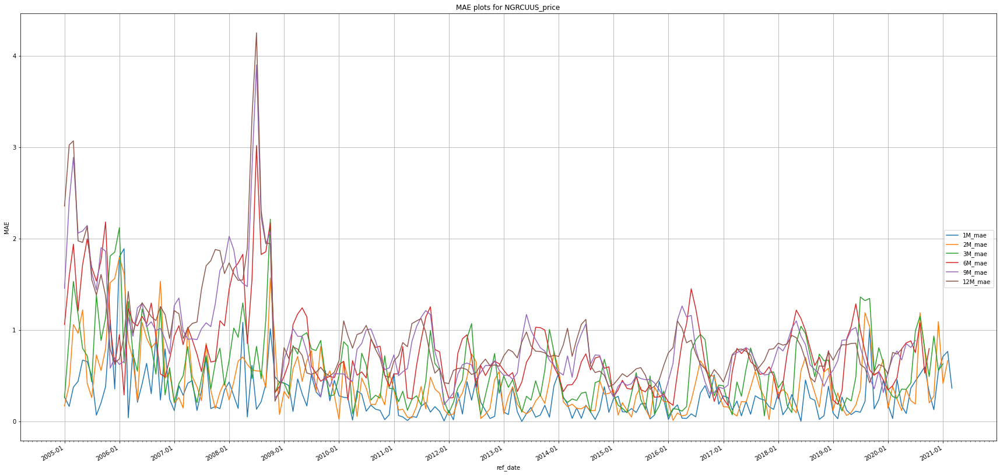

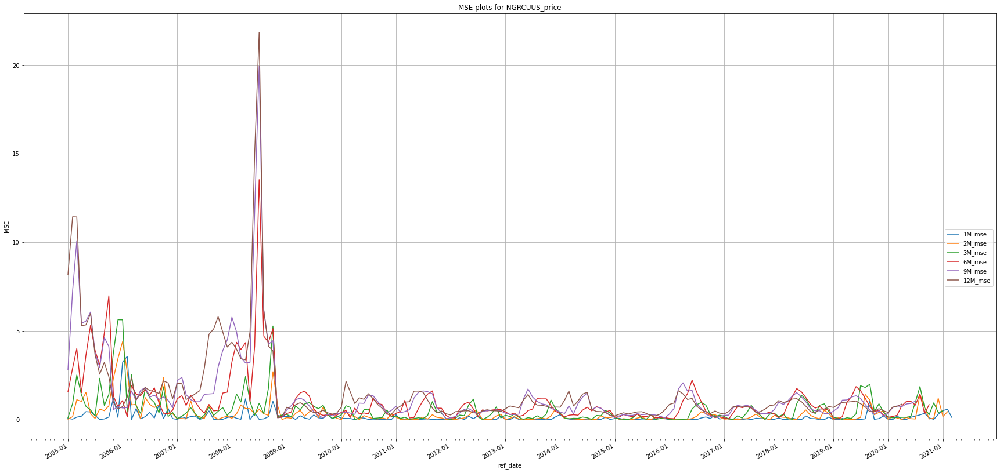

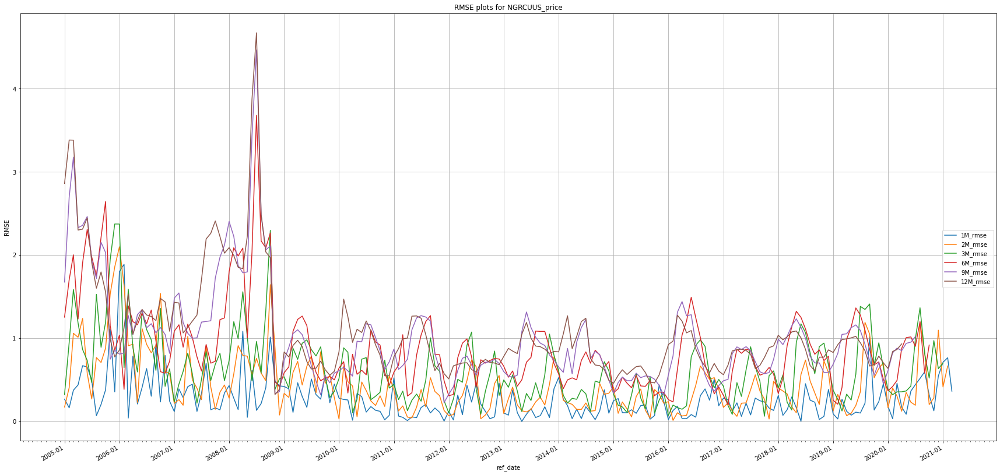

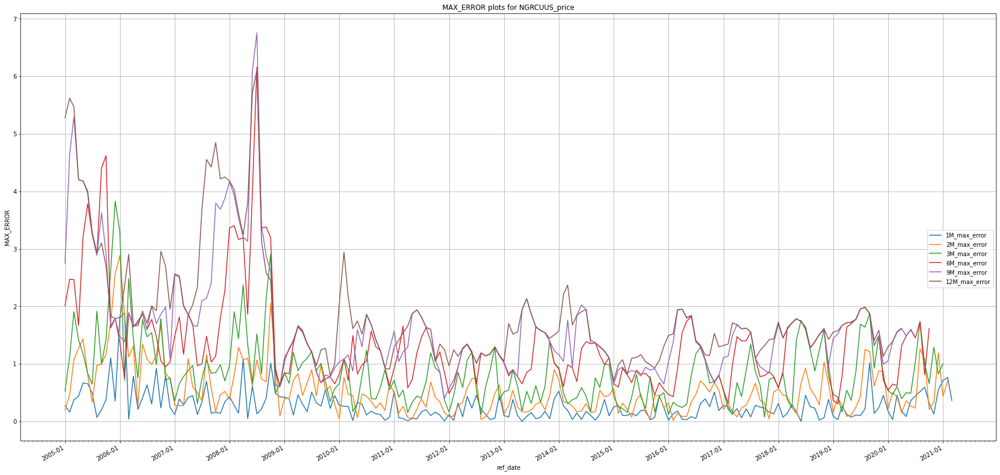




Plotting Evaluations for NGRCUUS_pct


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,NGRCUUS,2005-01-01,0.009539,0.000091,0.009539,0.009539,0.017393,0.000504,0.022456,0.031597,...,0.039961,0.072817,0.021765,0.000934,0.030568,0.072817,0.036850,0.002741,0.052359,0.128250
1,NGRCUUS,2005-02-01,0.021407,0.000458,0.021407,0.021407,0.015931,0.000271,0.016461,0.020073,...,0.050381,0.080663,0.039902,0.002584,0.050836,0.085926,0.041953,0.003039,0.055124,0.129385
2,NGRCUUS,2005-03-01,0.007742,0.000060,0.007742,0.007742,0.026918,0.001358,0.036853,0.052089,...,0.038004,0.071402,0.042053,0.003157,0.056183,0.121205,0.054305,0.006252,0.079072,0.204427
3,NGRCUUS,2005-04-01,0.023018,0.000530,0.023018,0.023018,0.061380,0.003767,0.061380,0.061524,...,0.026665,0.046637,0.042392,0.003029,0.055038,0.118158,0.054285,0.005073,0.071226,0.150080
4,NGRCUUS,2005-05-01,0.017388,0.000302,0.017388,0.017388,0.049518,0.002576,0.050756,0.060659,...,0.043037,0.080848,0.048775,0.003922,0.062628,0.116072,0.044374,0.003833,0.061909,0.140250
5,NGRCUUS,2005-06-01,0.009820,0.000096,0.009820,0.009820,0.056216,0.003216,0.056707,0.063658,...,0.059128,0.114255,0.051983,0.004973,0.070518,0.140314,0.046332,0.003478,0.058973,0.117967
6,NGRCUUS,2005-07-01,0.048506,0.002353,0.048506,0.048506,0.023781,0.000720,0.026834,0.036212,...,0.059431,0.114315,0.051010,0.004624,0.067998,0.113717,0.043608,0.002878,0.053645,0.113138
7,NGRCUUS,2005-08-01,0.054426,0.002962,0.054426,0.054426,0.033008,0.001090,0.033014,0.033630,...,0.056720,0.078975,0.047885,0.003802,0.061658,0.130378,0.043283,0.002469,0.049685,0.080088
8,NGRCUUS,2005-09-01,0.014315,0.000205,0.014315,0.014315,0.045484,0.002121,0.046058,0.052733,...,0.082719,0.154540,0.039406,0.002484,0.049837,0.094063,0.041196,0.002488,0.049876,0.097224
9,NGRCUUS,2005-10-01,0.023150,0.000536,0.023150,0.023150,0.062357,0.005289,0.072723,0.099777,...,0.079414,0.113157,0.043445,0.002575,0.050744,0.096506,0.045497,0.002830,0.053200,0.099667


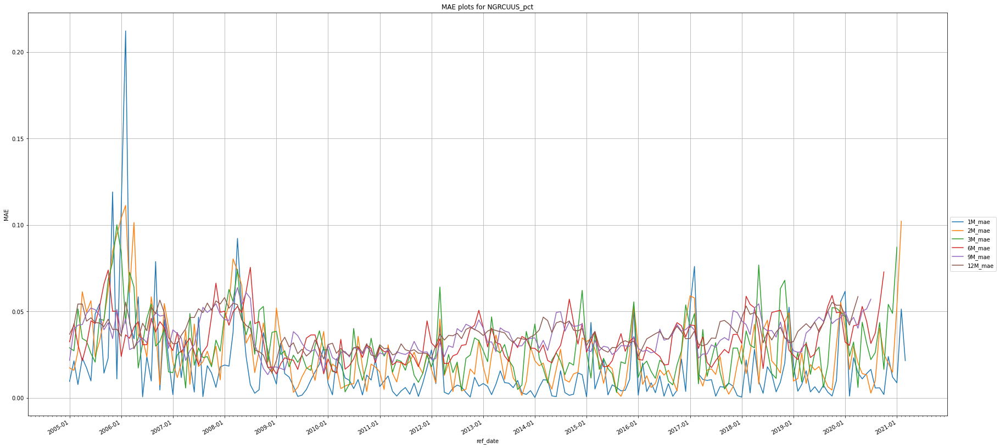

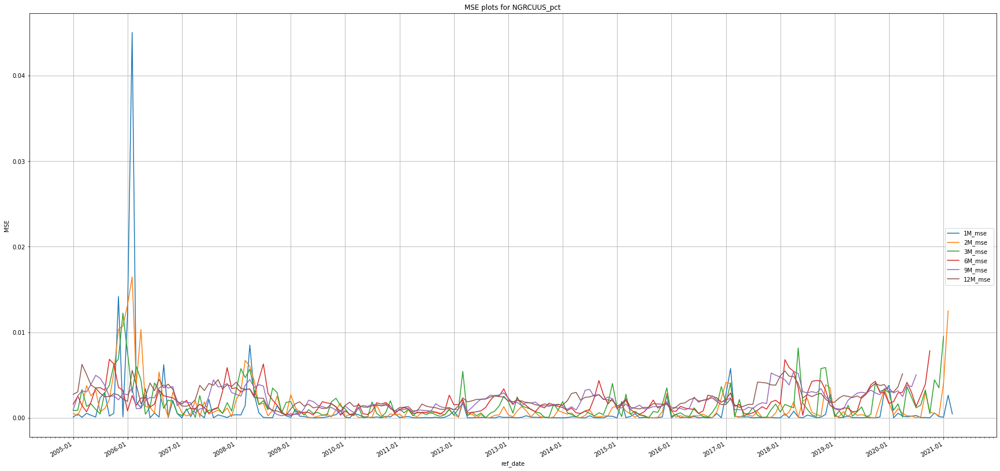

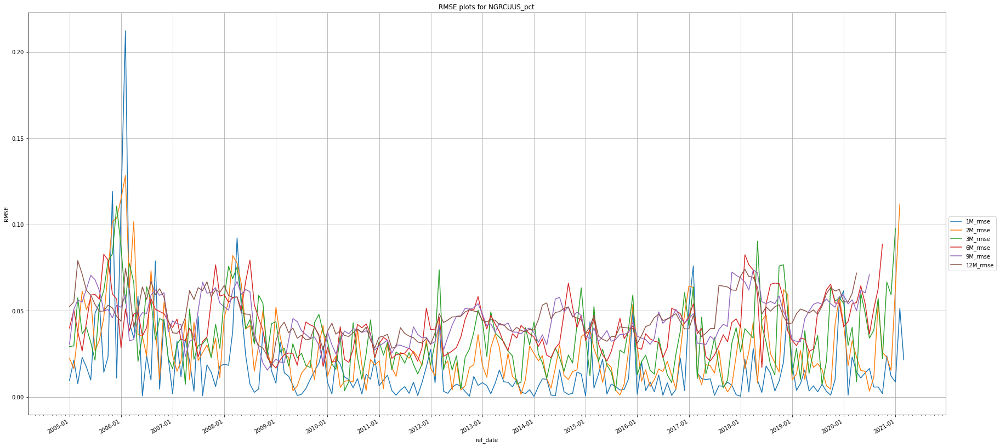

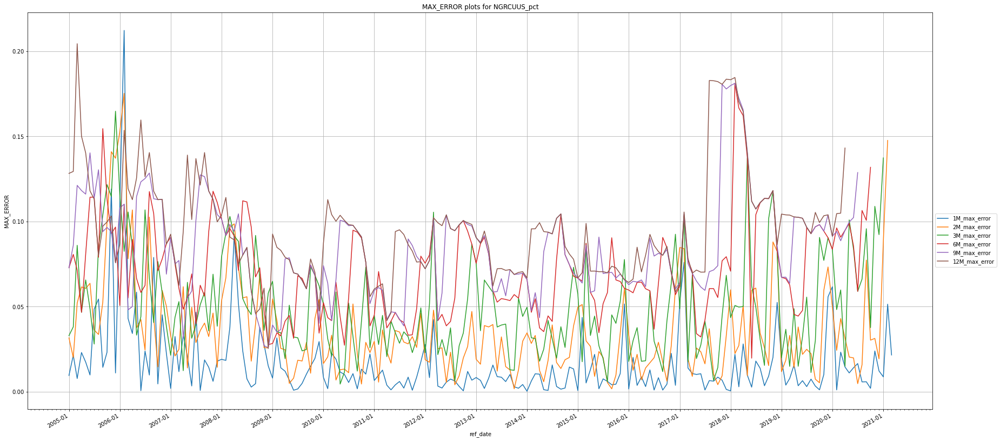




Plotting Evaluations for ESRCUUS_price


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,ESRCUUS,2007-10-01,0.035490,0.001260,0.035490,0.035490,0.069330,0.006961,0.083435,0.11575,...,0.106330,0.193414,0.152337,0.030276,0.174000,0.266690,0.278026,0.123057,0.350795,0.617490
1,ESRCUUS,2007-11-01,0.010970,0.000120,0.010970,0.010970,0.070570,0.005573,0.074653,0.09492,...,0.134854,0.209894,0.210516,0.055315,0.235191,0.429480,0.374353,0.201709,0.449120,0.739940
2,ESRCUUS,2007-12-01,0.059060,0.003488,0.059060,0.059060,0.031589,0.001126,0.033550,0.04289,...,0.185039,0.260390,0.317921,0.124089,0.352262,0.538020,0.432832,0.240659,0.490570,0.790290
3,ESRCUUS,2008-01-01,0.030012,0.000901,0.030012,0.030012,0.049275,0.002428,0.049277,0.04976,...,0.264477,0.314190,0.408537,0.203406,0.451005,0.678620,0.523297,0.337914,0.581304,0.912248
4,ESRCUUS,2008-02-01,0.053990,0.002915,0.053990,0.053990,0.156810,0.024689,0.157127,0.16678,...,0.307601,0.473510,0.488188,0.289668,0.538209,0.783970,0.523152,0.324717,0.569840,0.843930
5,ESRCUUS,2008-03-01,0.070920,0.005030,0.070920,0.070920,0.063125,0.004015,0.063366,0.06865,...,0.326211,0.450630,0.418849,0.213773,0.462356,0.702900,0.432445,0.234958,0.484725,0.764310
6,ESRCUUS,2008-04-01,0.053680,0.002882,0.053680,0.053680,0.098340,0.009671,0.098343,0.09906,...,0.458078,0.602270,0.541075,0.333196,0.577231,0.833018,0.545072,0.326313,0.571238,0.796850
7,ESRCUUS,2008-05-01,0.042350,0.001794,0.042350,0.042350,0.173730,0.030183,0.173734,0.17489,...,0.495279,0.634310,0.469502,0.244914,0.494888,0.684960,0.565454,0.334053,0.577973,0.734960
8,ESRCUUS,2008-06-01,0.131140,0.017198,0.131140,0.131140,0.210610,0.046922,0.216615,0.26126,...,0.406479,0.571720,0.352122,0.167019,0.408680,0.598150,0.497828,0.256670,0.506626,0.648150
9,ESRCUUS,2008-07-01,0.064920,0.004215,0.064920,0.064920,0.103655,0.011123,0.105465,0.12311,...,0.286284,0.405988,0.260538,0.086276,0.293728,0.425380,0.267265,0.095977,0.309801,0.491128


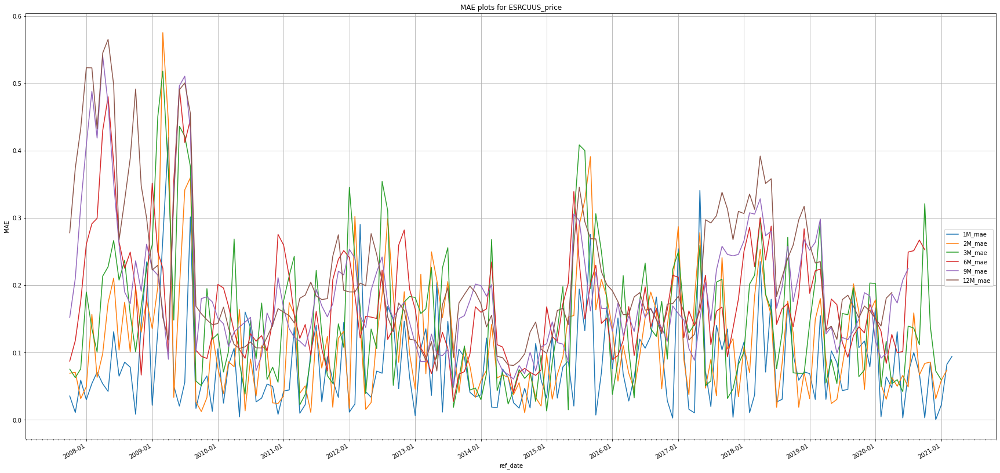

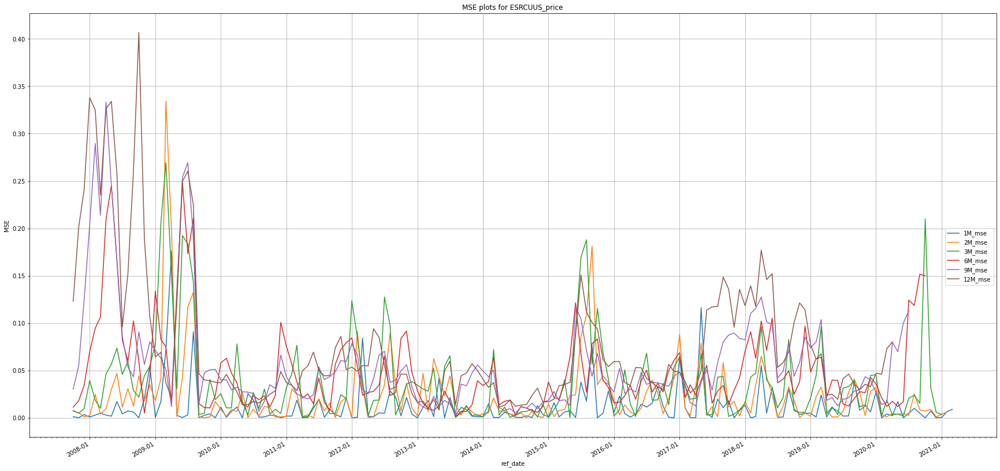

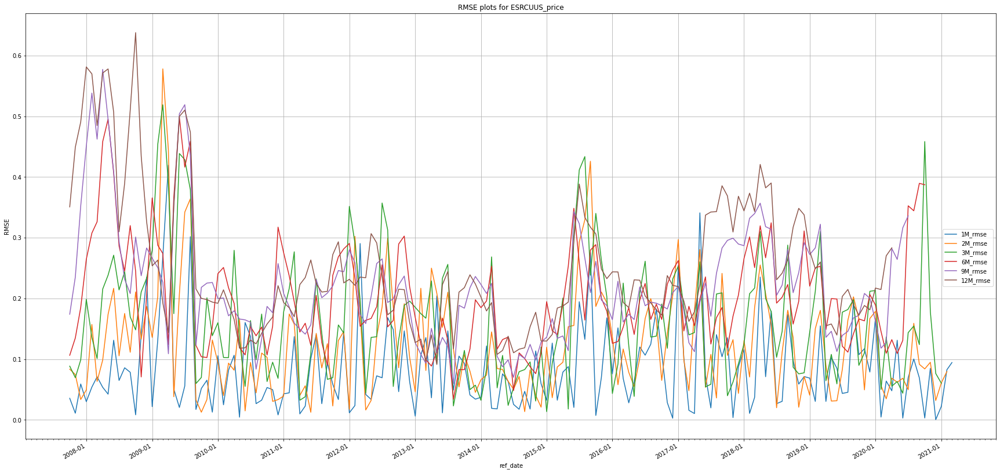

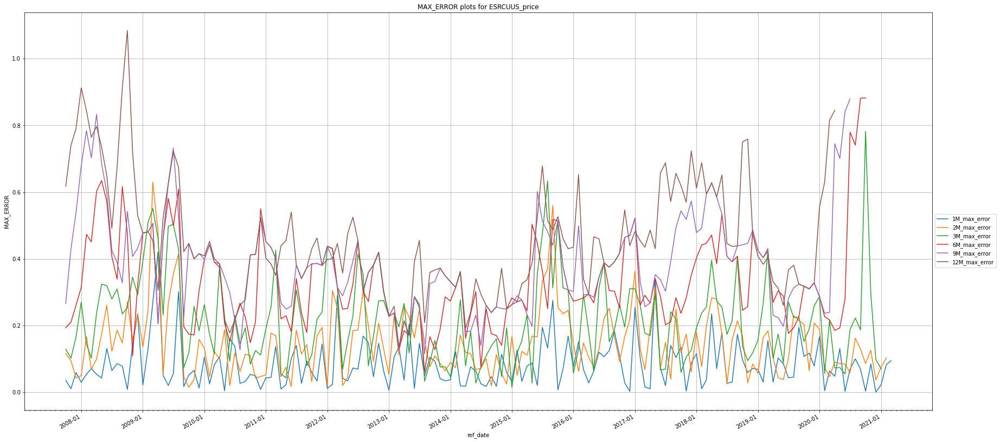




Plotting Evaluations for ESRCUUS_pct


,commod_id,ref_date,1M_mae,1M_mse,1M_rmse,1M_max_error,2M_mae,2M_mse,2M_rmse,2M_max_error,...,6M_rmse,6M_max_error,9M_mae,9M_mse,9M_rmse,9M_max_error,12M_mae,12M_mse,12M_rmse,12M_max_error
0,ESRCUUS,2007-10-01,0.000941,8.855944e-07,0.000941,0.000941,0.015310,2.419839e-04,0.015556,0.018066,...,0.009116,0.016626,0.006258,0.000062,0.007852,0.015086,0.007737,0.000081,0.008980,0.015207
1,ESRCUUS,2007-11-01,0.012652,1.600834e-04,0.012652,0.012652,0.008870,9.996771e-05,0.009998,0.013484,...,0.010162,0.020845,0.006307,0.000052,0.007230,0.012315,0.007810,0.000095,0.009751,0.021628
2,ESRCUUS,2007-12-01,0.004035,1.627985e-05,0.004035,0.004035,0.003152,1.096270e-05,0.003311,0.004166,...,0.010077,0.018287,0.007797,0.000087,0.009306,0.017049,0.009226,0.000113,0.010609,0.021588
3,ESRCUUS,2008-01-01,0.006914,4.779784e-05,0.006914,0.006914,0.008349,1.369479e-04,0.011702,0.016549,...,0.004515,0.006804,0.006951,0.000082,0.009040,0.019400,0.008757,0.000138,0.011761,0.023005
4,ESRCUUS,2008-02-01,0.003410,1.162634e-05,0.003410,0.003410,0.004852,2.972688e-05,0.005452,0.007339,...,0.005405,0.010380,0.007384,0.000113,0.010611,0.023018,0.011250,0.000202,0.014204,0.026962
5,ESRCUUS,2008-03-01,0.004400,1.936126e-05,0.004400,0.004400,0.000765,9.268273e-07,0.000963,0.001350,...,0.010499,0.021791,0.008989,0.000137,0.011703,0.023176,0.010196,0.000199,0.014111,0.028844
6,ESRCUUS,2008-04-01,0.005361,2.874208e-05,0.005361,0.005361,0.003302,2.135960e-05,0.004622,0.006536,...,0.010889,0.019571,0.011091,0.000192,0.013854,0.023118,0.011470,0.000178,0.013327,0.023879
7,ESRCUUS,2008-05-01,0.000236,5.554019e-08,0.000236,0.000236,0.002308,9.816365e-06,0.003133,0.004427,...,0.012867,0.022930,0.014356,0.000284,0.016838,0.030780,0.010681,0.000170,0.013048,0.023691
8,ESRCUUS,2008-06-01,0.000216,4.670936e-08,0.000216,0.000216,0.006297,4.522635e-05,0.006725,0.008657,...,0.011685,0.021295,0.011646,0.000240,0.015499,0.032622,0.010062,0.000139,0.011774,0.022057
9,ESRCUUS,2008-07-01,0.003079,9.482021e-06,0.003079,0.003079,0.003978,1.620535e-05,0.004026,0.004597,...,0.012642,0.021249,0.014027,0.000282,0.016794,0.034373,0.012381,0.000204,0.014275,0.026896


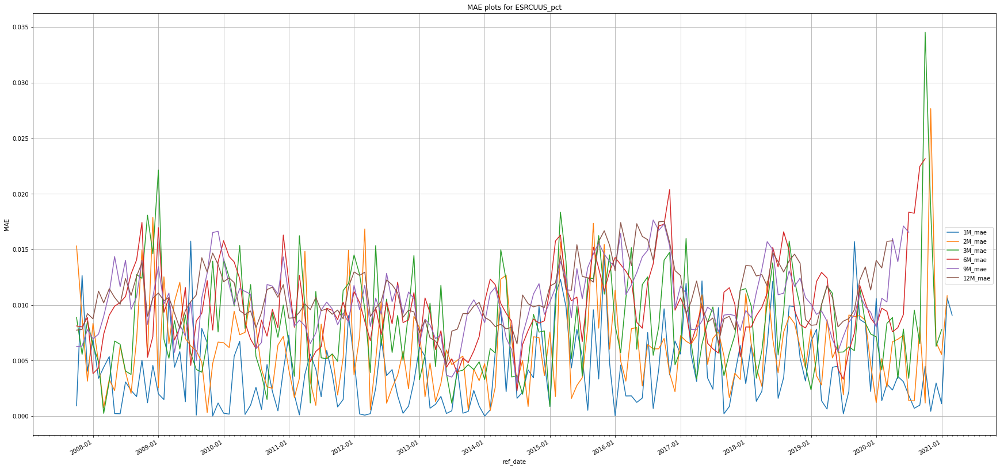

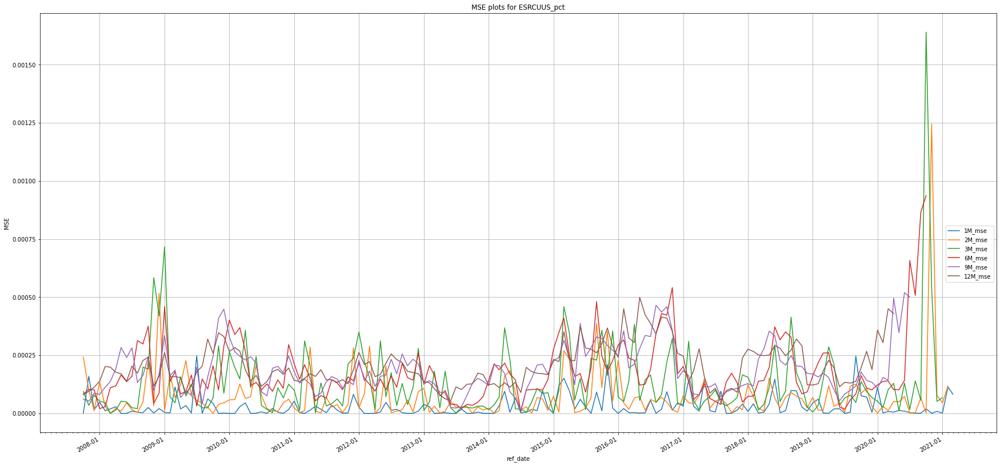

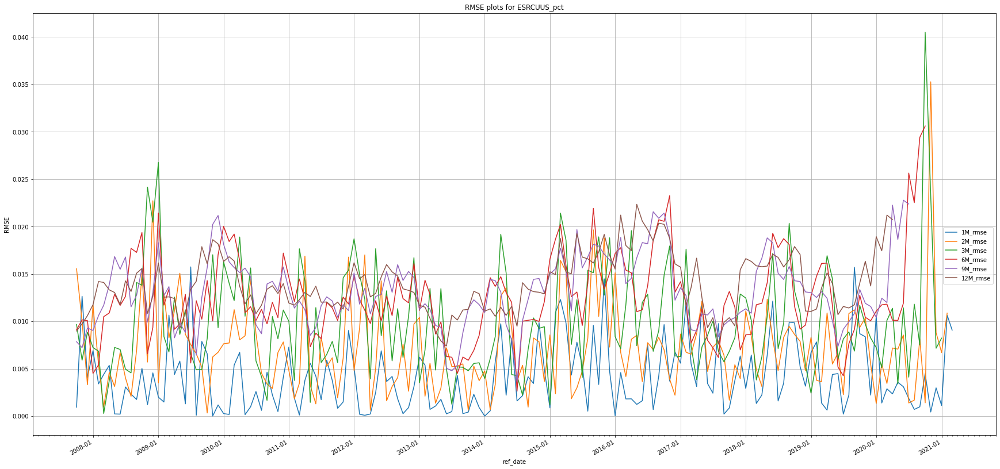

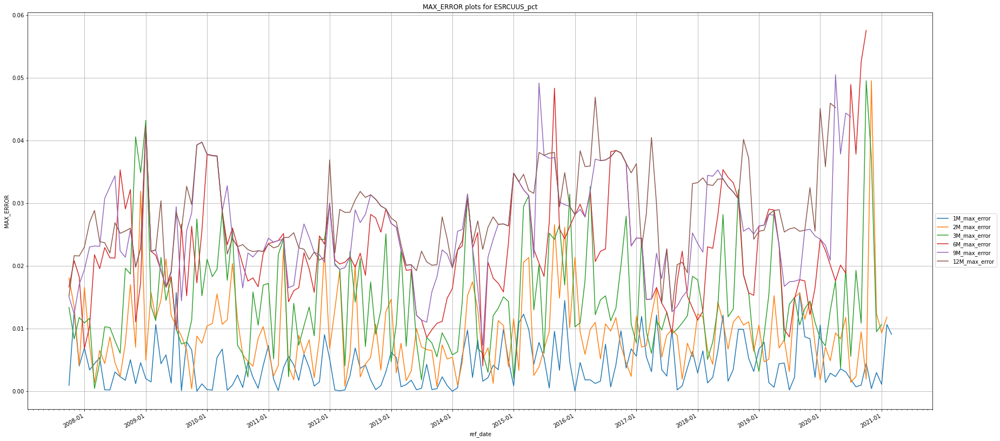

In [5]:
for commod_id, val_type in product(commods, ("price", "pct")):
    print(f"Plotting Evaluations for {commod_id}_{val_type}")
    df = pd.read_csv(os.path.join(output_dir, "forecast_evals", f"{commod_id}_{val_type}.csv"))
    display(df.head(10))
    for metric in metrics:
        y_ax = [f"{x}M_{metric}" for x in time_horizons]
        line_plot_date(df, "ref_date", y_ax, f"{metric.upper()} plots for {commod_id}_{val_type}", ("ref_date", f"{metric.upper()}"), fig_size=(30, 15))